[6, 13, 10, 16]
9284.170458684714


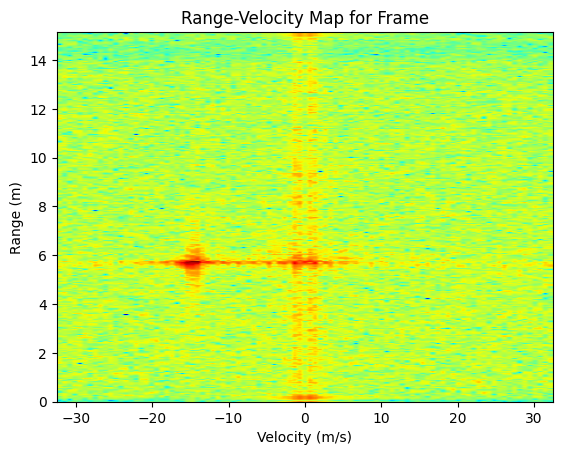

In [16]:
import numpy as np
from scipy import signal
import matplotlib.pyplot as plt
from scipy.signal import butter, filtfilt
import random

# Define file path and parameters
fileFullPath_1 = r'D:\Drone-Swarm-Detection-with-AWR2243\Our data\Radar_Data\Phantom4_3GHz\master_0000_data.bin';
fileFullPath_2 = r'D:\Drone-Swarm-Detection-with-AWR2243\Our data\Radar_Data\Phantom4_3GHz\master_0000_data.bin';
fileFullPath_3 = r'D:\Drone-Swarm-Detection-with-AWR2243\Our data\Radar_Data\Phantom4_3GHz\master_0000_data.bin';
fileFullPath_4 = r'D:\Drone-Swarm-Detection-with-AWR2243\Our data\Radar_Data\Phantom4_3GHz\master_0000_data.bin';
file_paths=[fileFullPath_1]
frameIdx = 50# Index of the frame to read
numSamplePerChirp = 256  # Number of samples per chirp
numChirpPerLoop = 12  # Number of chirps per loop
numLoops = 64 # Number of loops per frame
numRXPerDevice = 4  # Number of receiving channels per device
numDevices = 4  # Number of devices in the cascade (if needed)
# Create the filter for zero Doppler clutter removal
cutoff_freq =10  # Set cutoff frequency for the high-pass filter (Hz)
sampling_freq = 1000  # Sampling frequency (example value, should match your data)
def butter_highpass(cutoff, fs, order=6):
    """Design a Butterworth high-pass filter."""
    nyquist = 0.5 * fs
    normal_cutoff = cutoff / nyquist
    b, a = butter(order, normal_cutoff, btype='high', analog=False)
    return b, a
b, a = butter_highpass(cutoff_freq, sampling_freq)
# Function to read binary radar data
def readBinFile(fileFullPath, frameIdx, numSamplePerChirp, numChirpPerLoop, numLoops, numRXPerDevice):
    Expected_Num_SamplesPerFrame = numSamplePerChirp * numChirpPerLoop * numLoops * numRXPerDevice * 2
    with open(fileFullPath, 'rb') as fp:
        # Move to the desired frame in the file
        fp.seek((frameIdx - 1) * Expected_Num_SamplesPerFrame * 2)
        adcData1 = np.fromfile(fp, dtype=np.uint16, count=Expected_Num_SamplesPerFrame)

    # Convert the 16-bit data to signed integers
    neg = (adcData1 >> 15) == 1  # Check the sign bit
    adcData1 = adcData1.astype(np.int32)
    adcData1[neg] -= 2**16

    # Combine the I and Q channels into complex values
    adcData1 = adcData1[0::2] + 1j * adcData1[1::2]

    # Reshape and permute the data
    adcData1Complex = np.reshape(adcData1, (numRXPerDevice, numSamplePerChirp, numChirpPerLoop, numLoops), order='F')
    adcData1Complex = np.transpose(adcData1Complex, (1, 3, 0, 2))  # Permute dimensions
    return adcData1Complex
# Define the range of possible values
min_value = 4
max_value = 20

# Number of values in the list
num_values = 4

# Function to check if all values in the list have a minimum distance of 3
def has_minimum_distance(values, min_distance=3):
    # Check the distance between each pair of values
    return all(abs(values[i] - values[j]) >= min_distance for i in range(len(values)) for j in range(i + 1, len(values)))

# Generate up to 30 unique valid combinations
valid_combinations = set()

while len(valid_combinations) < 1:
    # Randomly select 4 values within the range
    candidate = random.sample(range(min_value, max_value + 1), num_values)
    
    # Check if the candidate list meets the minimum distance requirement
    if has_minimum_distance(candidate):
        # Convert the list to a tuple to ensure uniqueness in the set
        valid_combinations.add(tuple(candidate))

# Convert each tuple back to a list and print the results
for comb in valid_combinations:
    print(list(comb))
    #frame_num_list=list(comb)
    frame_num_list=[i for i in range(126,127)]
    add_both_chirps_matrix = np.zeros((256, 64))

    for i in range(len(frame_num_list)):

        adcDataComplex= readBinFile(file_paths[0], frame_num_list[i], numSamplePerChirp, numChirpPerLoop, numLoops, numRXPerDevice)

        # Select antenna index and extract chirp ADC matrix
        # chirp_ADC_matrix = adcDataComplex[:, :, 3, :]
        # specific_transmitter_data = chirp_ADC_matrix[:, :, 0].T
        # if filter and b is not None and a is not None:
        #     specific_transmitter_data = filtfilt(b,a,specific_transmitter_data , axis=0)
        # chirps_matrix = specific_transmitter_data.T
        # specific_transmitter_data=np.transpose(specific_transmitter_data)
        # add_both_chirps_matrix=add_both_chirps_matrix+specific_transmitter_data
        chirp_ADC_matrix = adcDataComplex[:, :, 3, :]
        specific_transmitter_data = chirp_ADC_matrix[:, :, 0]
      
       
        add_both_chirps_matrix=add_both_chirps_matrix+specific_transmitter_data
        
    fc = 77e9
    c = 3e8
    sweepBandwidth =3.16e9
    chirpDuration = 30e-6

    
    if filter and b is not None and a is not None:
            add_both_chirps_matrix=np.transpose(add_both_chirps_matrix)
            add_both_chirps_matrix = filtfilt(b,a,add_both_chirps_matrix , axis=0)
            add_both_chirps_matrix=np.transpose(add_both_chirps_matrix)
            chirps_matrix = add_both_chirps_matrix

    # Define parameters
    slope = 78.9857e12
    chirp_duration = 30e-6
    c = 3e8  # Speed of light in m/s
    radar_data= chirps_matrix 
    # Assuming radar_data is already defined as a numpy array
    n_samples = radar_data.shape[1]  # Get number of samples per chirp
    n_chirps = radar_data.shape[0]  # Get number of chirps

    # Calculate the sample rate
    sample_rate = n_samples / chirp_duration

    # Create the time vector for range shift
    time = np.arange(n_samples) / sample_rate
    range_shift = 0

    # Calculate the frequency shift due to range shift
    frequency_shift_range = 2 * slope * range_shift / c

    # Calculate the phase shift for range shift
    phase_shift_range = 2 * np.pi * frequency_shift_range * time

    # Apply the range phase shift to radar data
    shifted_data_array = radar_data * np.exp(-1j * phase_shift_range)

    # Define velocity shift
    velocity_shift = 0

    # Create the time vector for velocity shift (column vector)
    time_velocity = np.arange(n_chirps) * chirp_duration

    # Calculate the frequency shift due to velocity shift
    frequency_shift_velocity = 2 * slope * velocity_shift / c

    # Calculate the phase shift for velocity shift
    phase_shift_velocity = 2 * np.pi * frequency_shift_velocity * time_velocity

    # Apply the velocity phase shift to the radar data
    shifted_data_array = shifted_data_array * np.exp(1j * phase_shift_velocity[:, np.newaxis])  # Broadcasting phase shift across samples


    Nfft_range = 320
    Nfft_doppler = 97

    range_fft = np.fft.fft(shifted_data_array, Nfft_range, axis=0)
    doppler_fft = np.fft.fftshift(np.fft.fft(range_fft, Nfft_doppler, axis=1), axes=1)
    


    range_res = c / (2 * sweepBandwidth)
    max_range = range_res * (Nfft_range - 1)
    range_axis = np.linspace(0, max_range, Nfft_range)

    velocity_res = (c / fc) / (2 * numLoops * chirpDuration * 12)
    max_velocity = (c / fc) / (chirpDuration * 4)
    velocity_axis = np.linspace(-max_velocity, max_velocity, Nfft_doppler)
    mean_value=np.mean(np.abs(doppler_fft))
    print( mean_value)
    final_matrix=np.abs(doppler_fft)
   
    # # Plot the Range-Velocity map (absolute value of FFT)
    plt.figure()
    plt.imshow(20*np.log(final_matrix), aspect='auto', extent=[velocity_axis[0], velocity_axis[-1], range_axis[0], range_axis[-1]], origin='lower',cmap='jet')
    #plt.imshow(20 * np.log10(np.abs(doppler_fft)), aspect='auto', extent=[velocity_axis[0], velocity_axis[-1], range_axis[0], range_axis[-1]], origin='lower',cmap='jet')
    plt.xlabel('Velocity (m/s)')
    plt.ylabel('Range (m)')
    plt.title(f'Range-Velocity Map for Frame')
    
        



[19, 10, 4, 13]
70986.35146642114


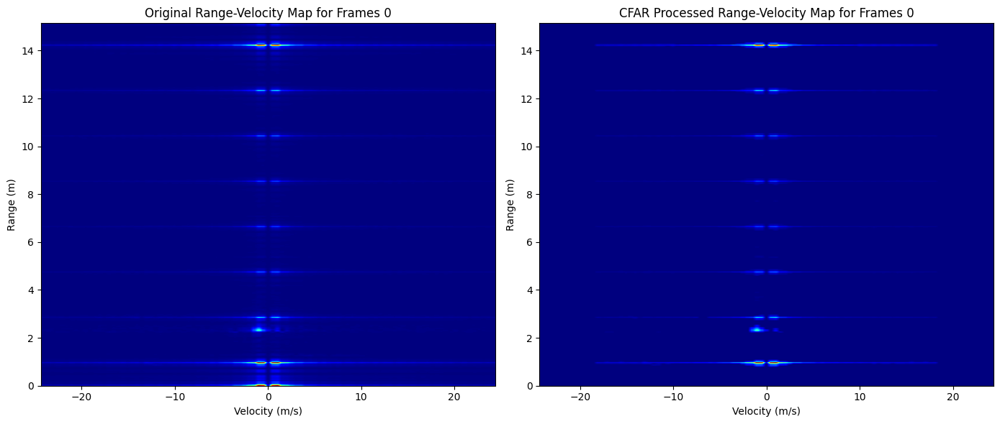

10707.799133064766


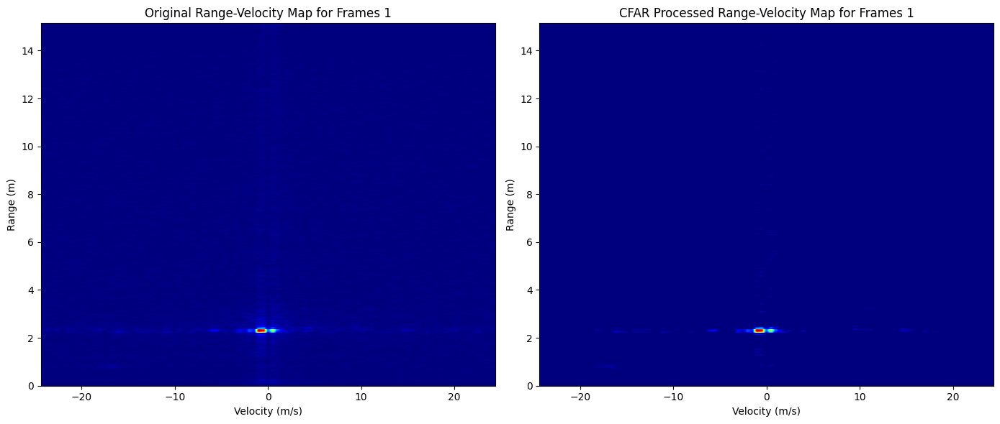

10362.716629584009


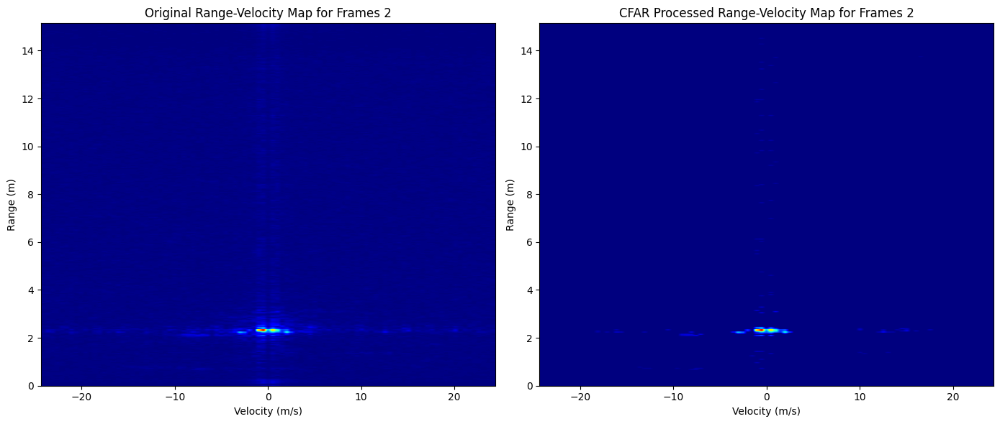

10227.503332414572


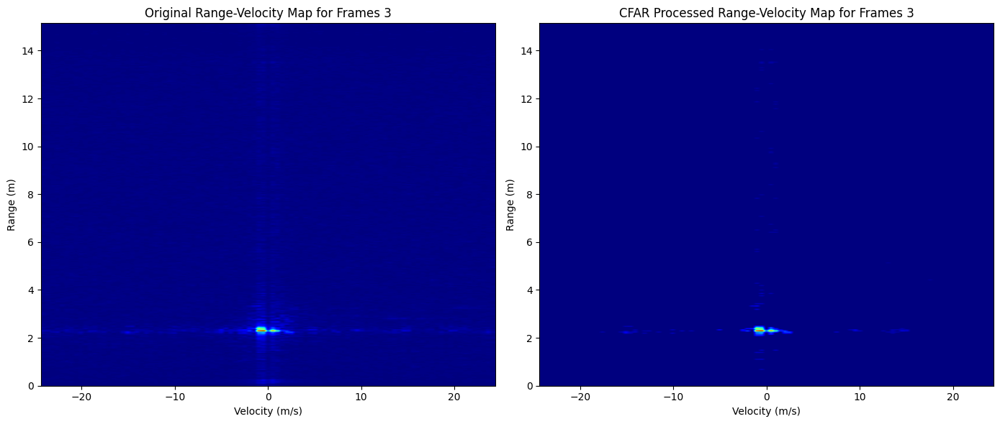

9668.471084084997


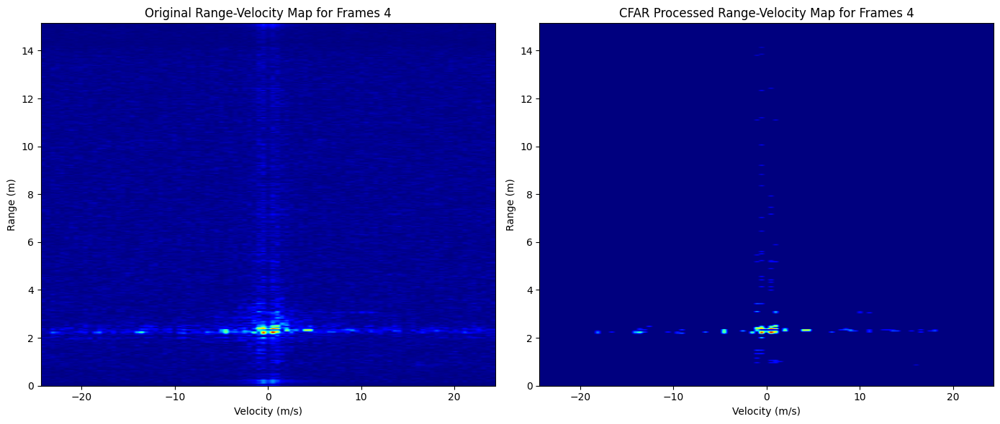

9464.264627846062


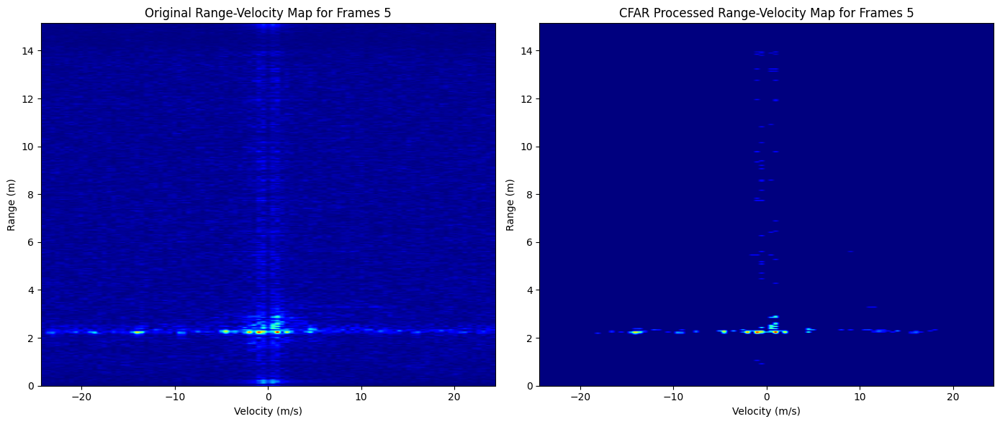

9445.528457741562


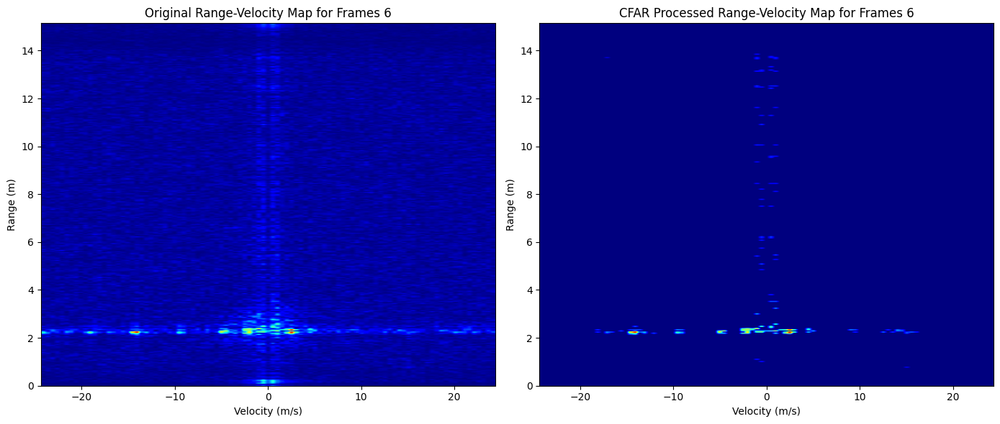

9423.142103263051


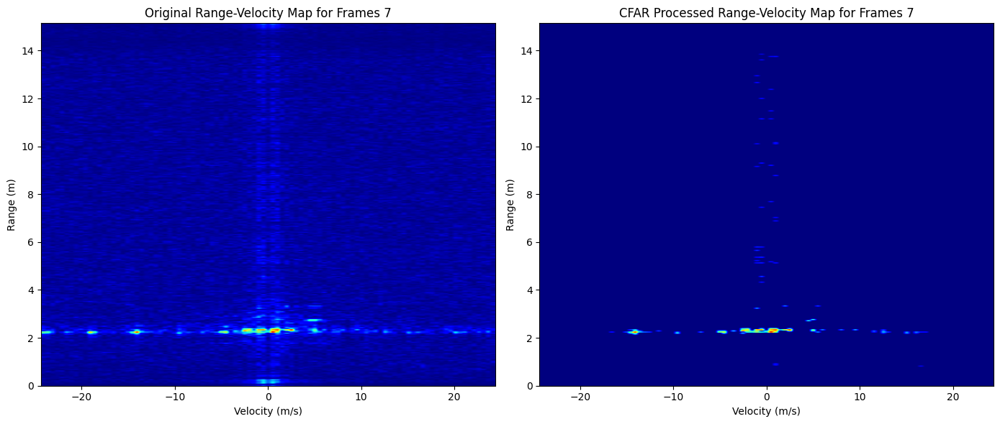

9410.432360894585


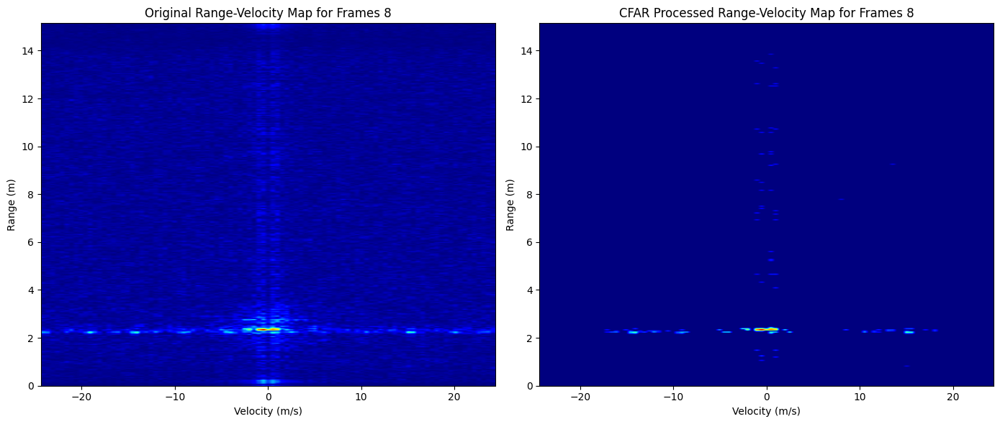

9727.974934552634


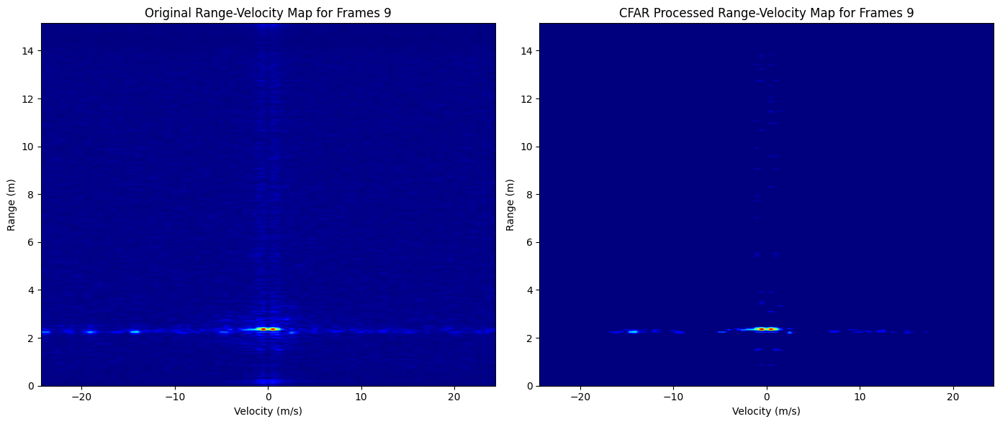

10044.611701452111


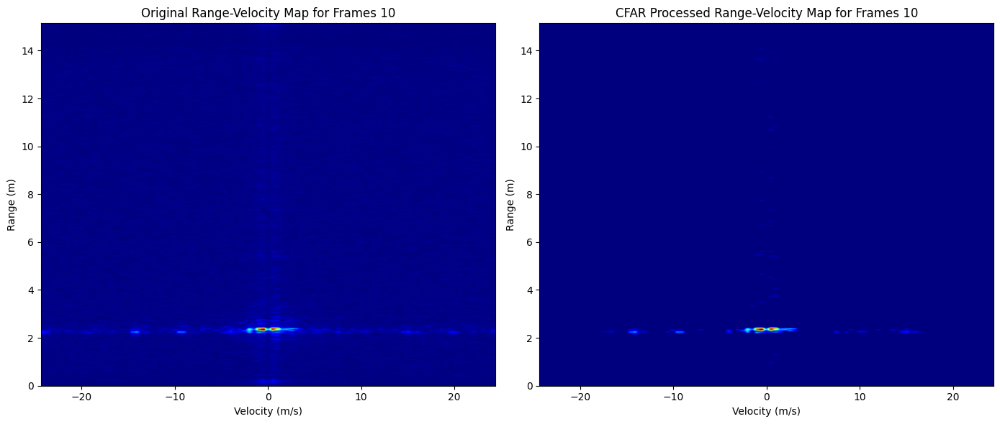

10282.233473958675


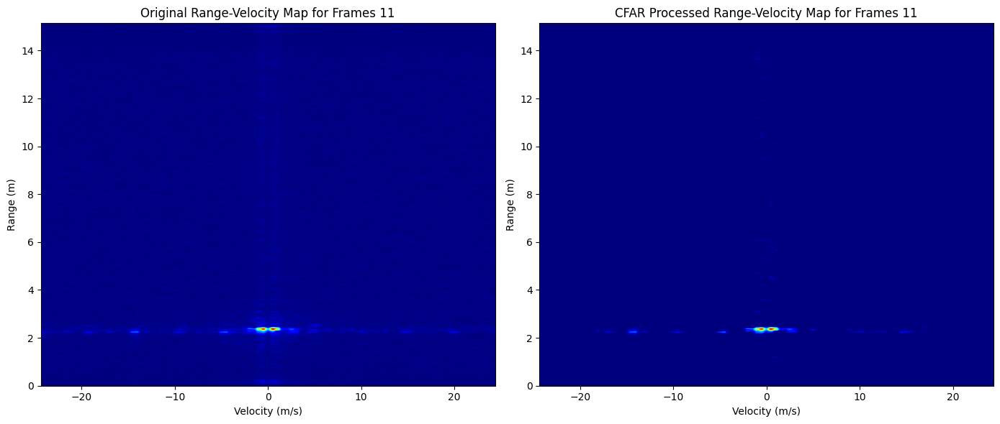

9765.333060101917


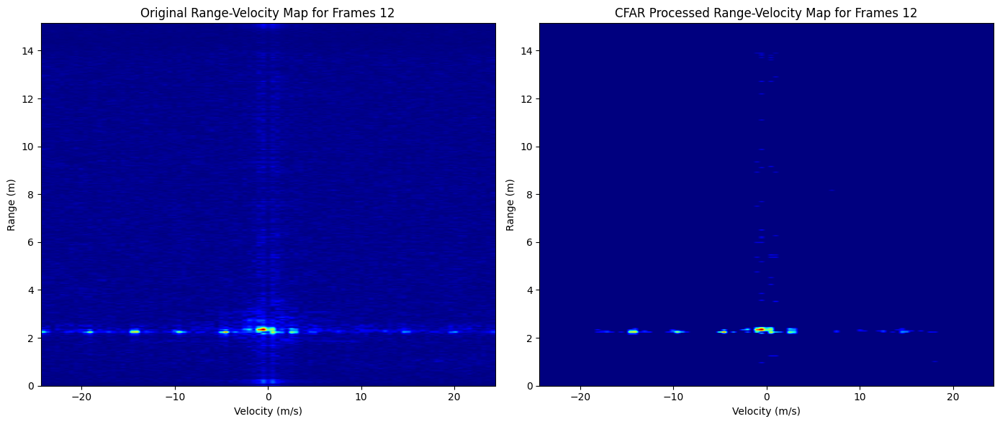

9628.437299724113


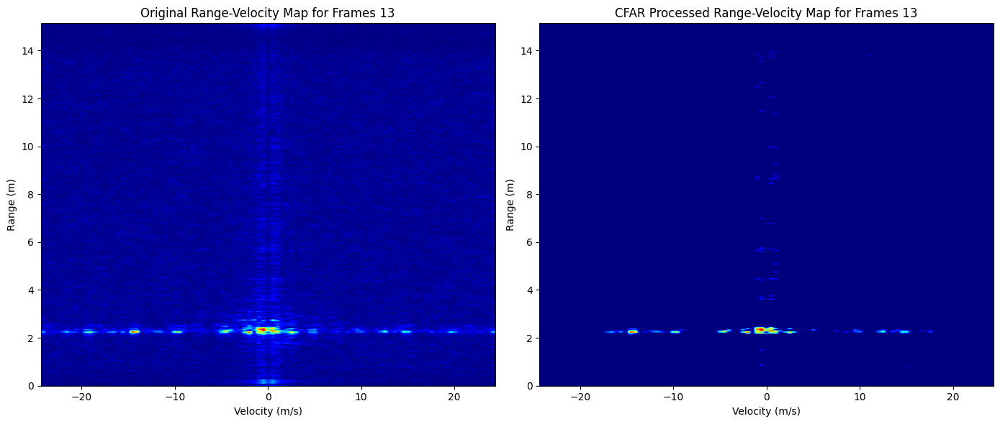

9491.235334222834


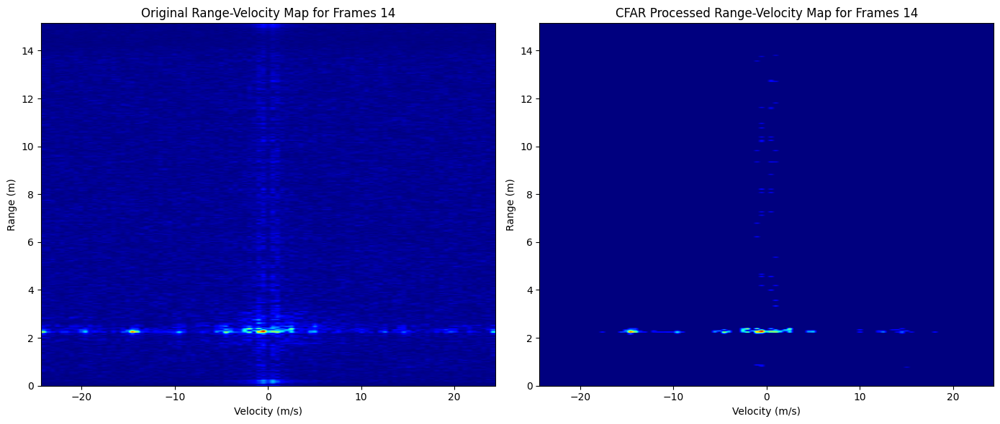

9406.734220601209


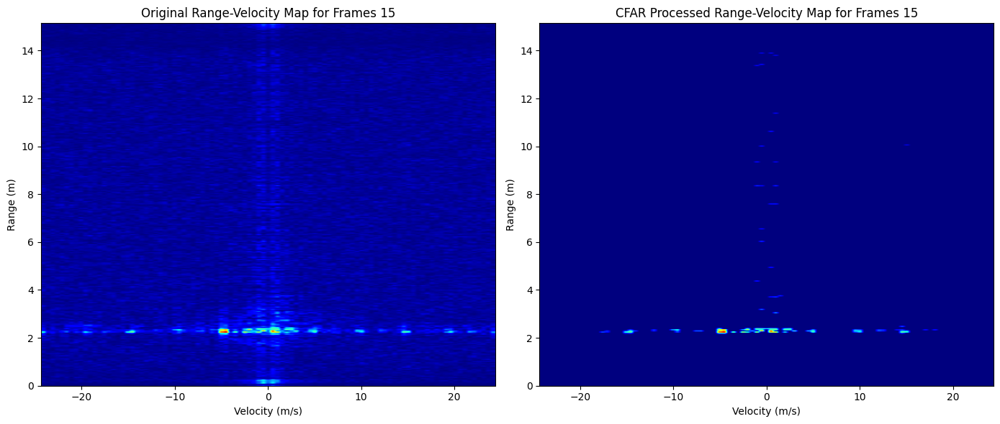

9469.707776820453


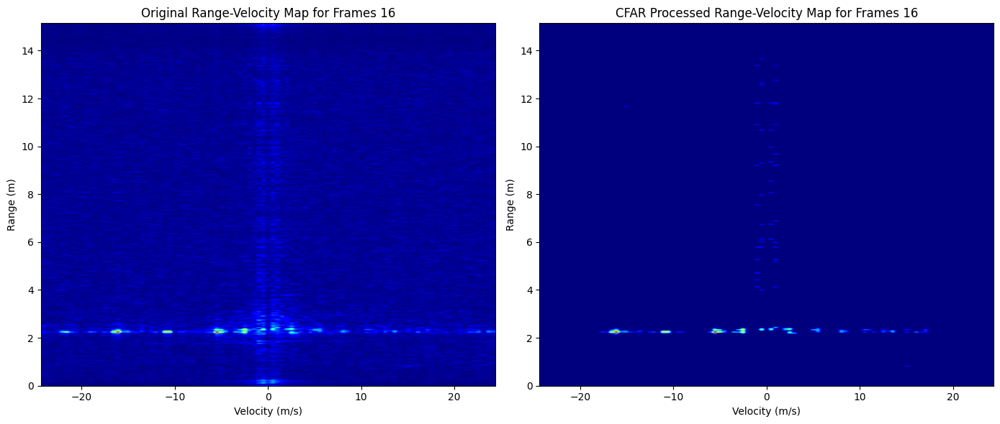

9465.953513720846


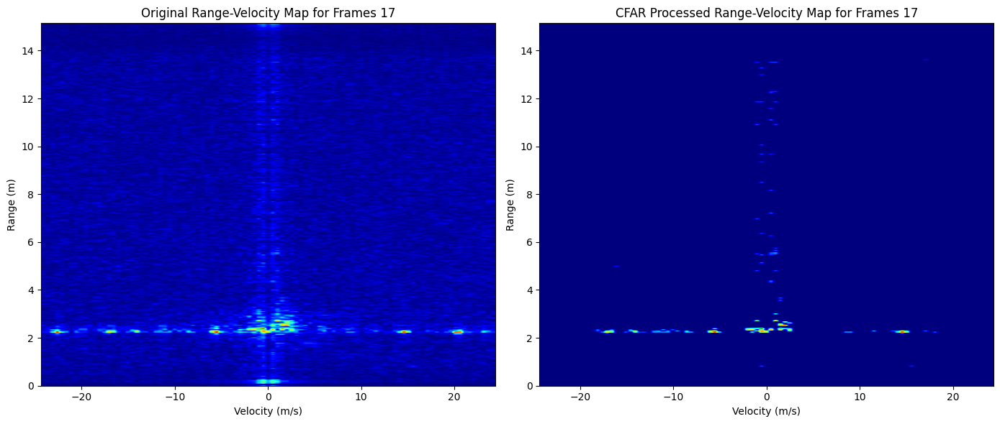

9500.319123878638


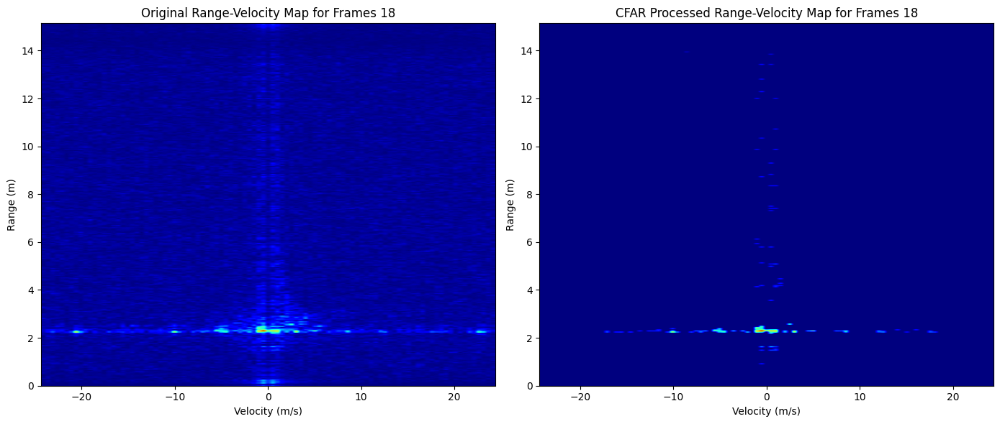

9547.73273384131


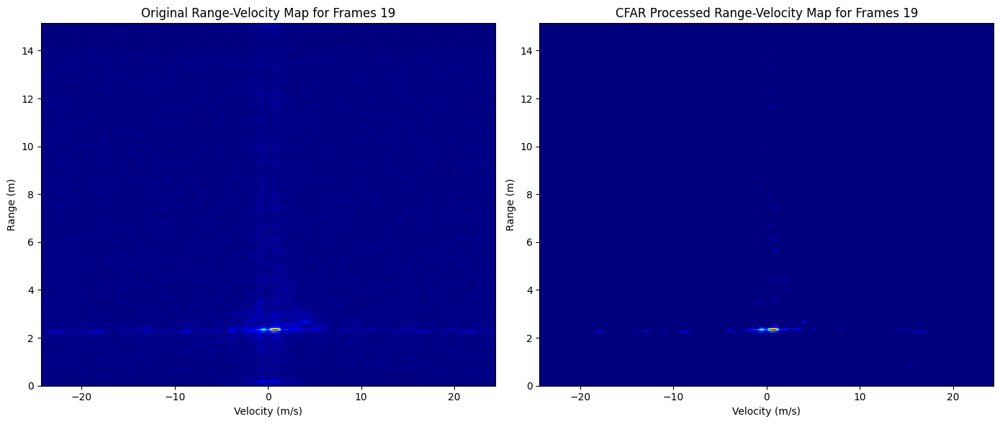

9063.552710216447


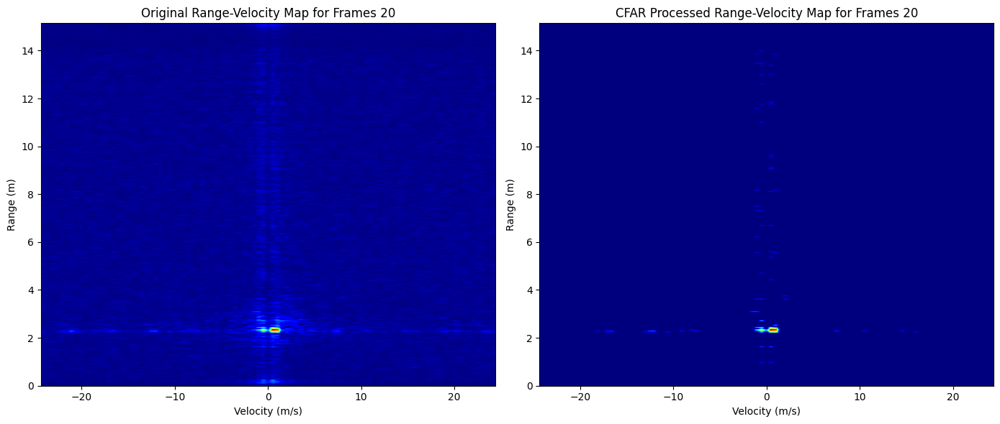

9050.745565888628


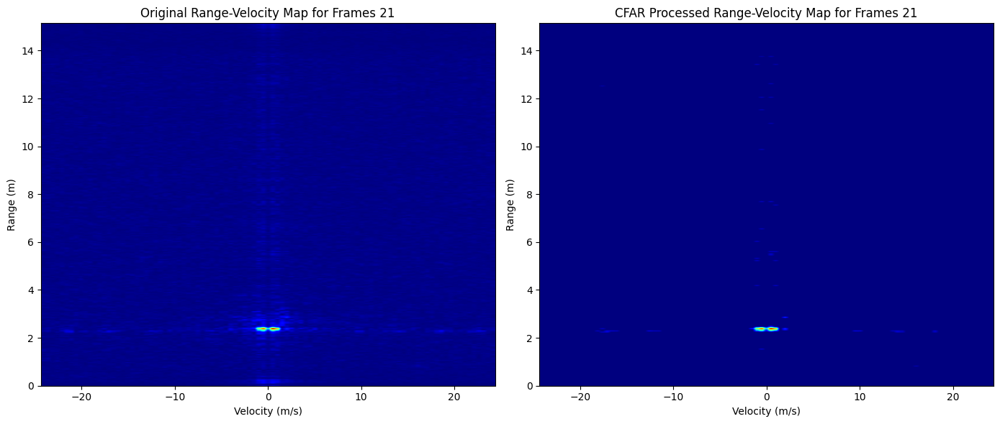

8893.055902293667


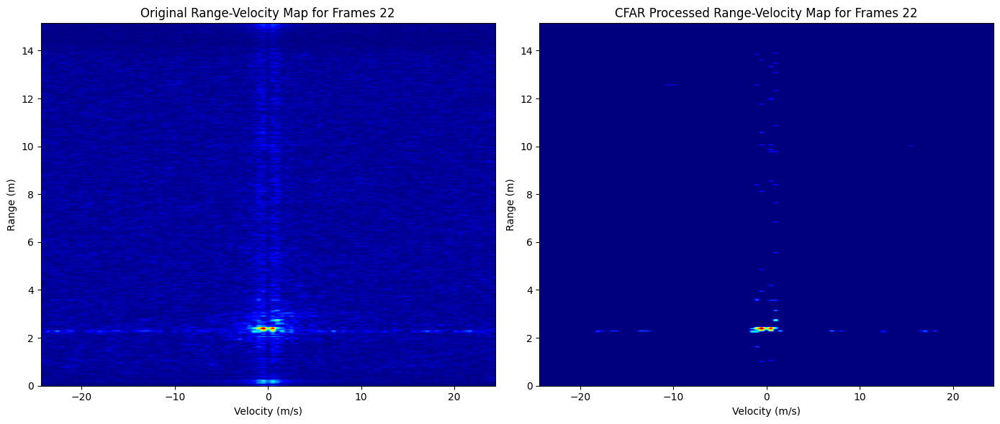

8661.893589342171


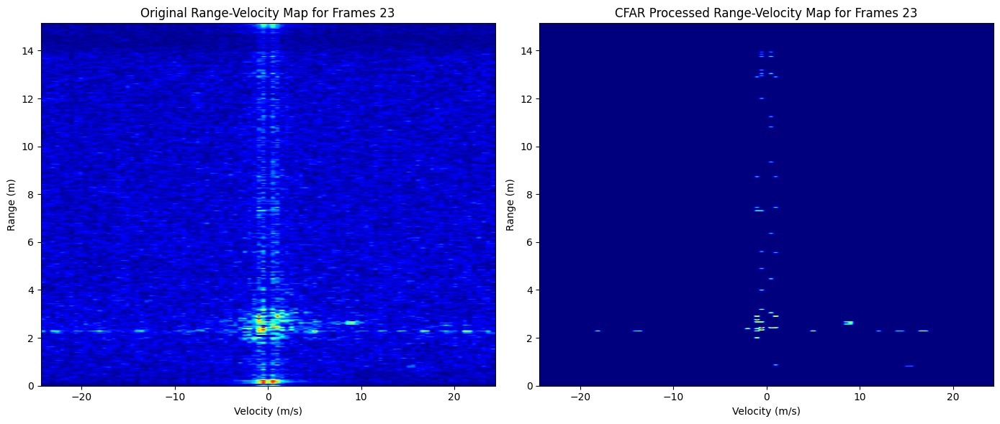

8677.836919426622


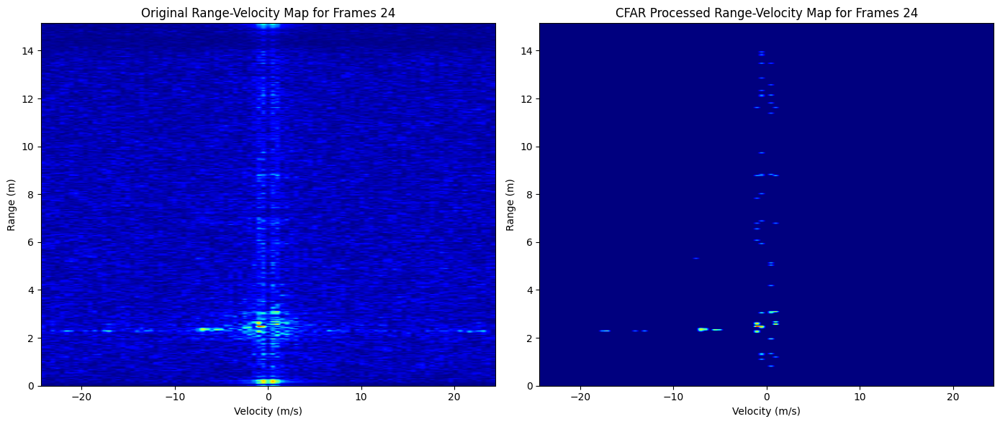

8722.96144504741


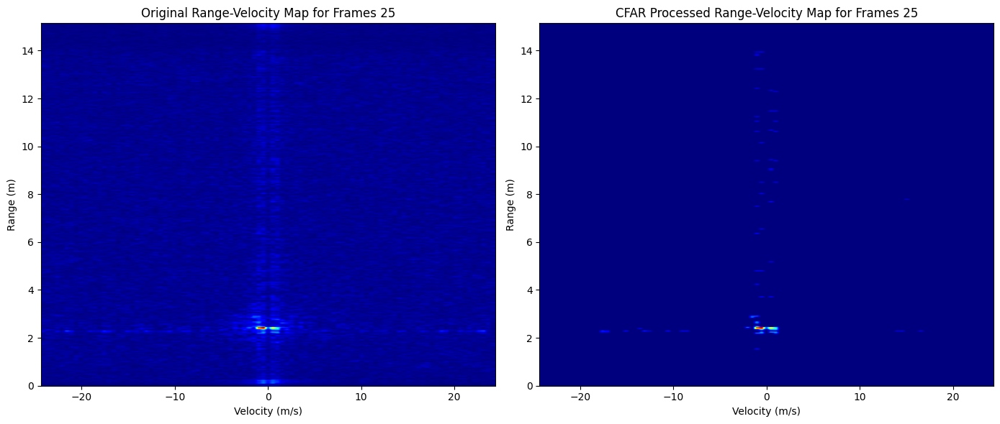

9133.480208570883


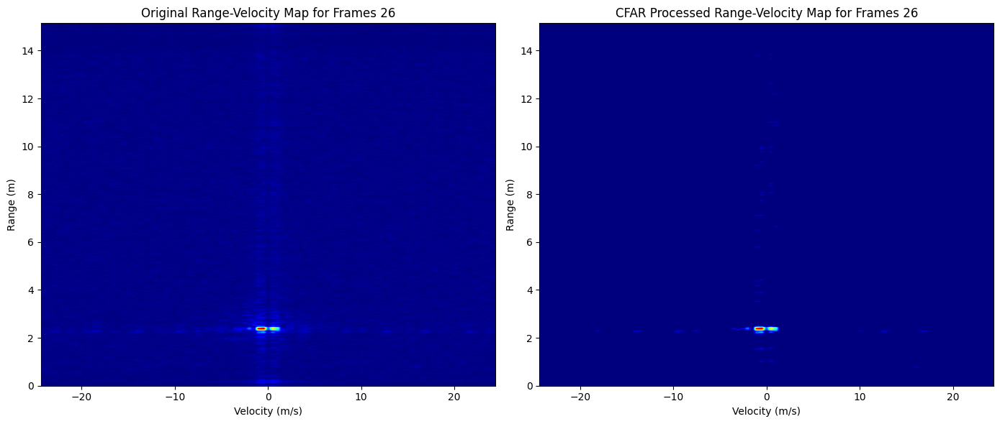

9077.47582010893


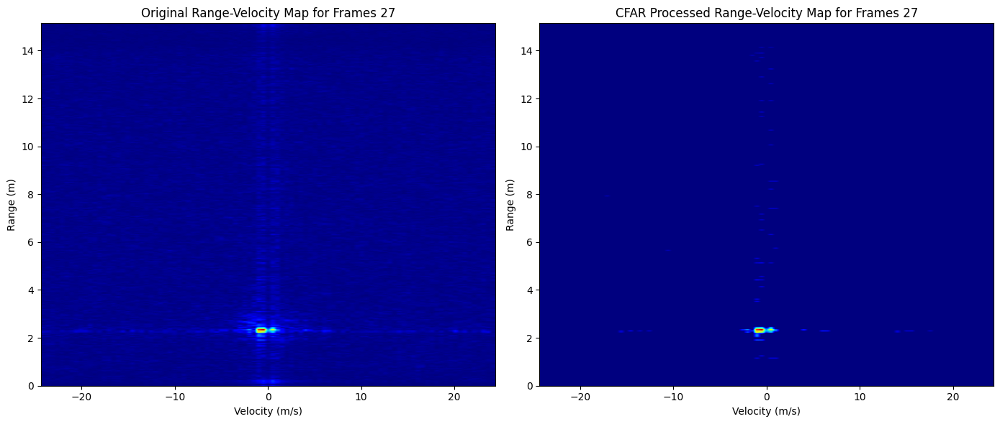

9357.546960775293


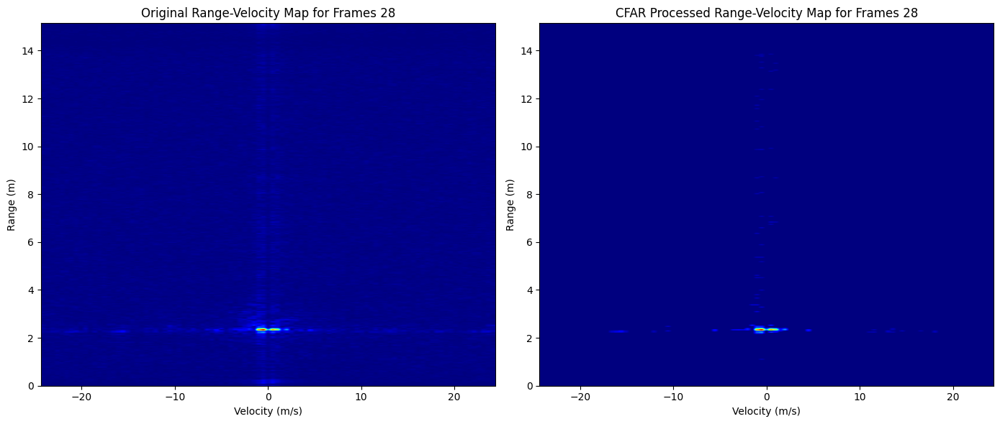

9506.137180346454


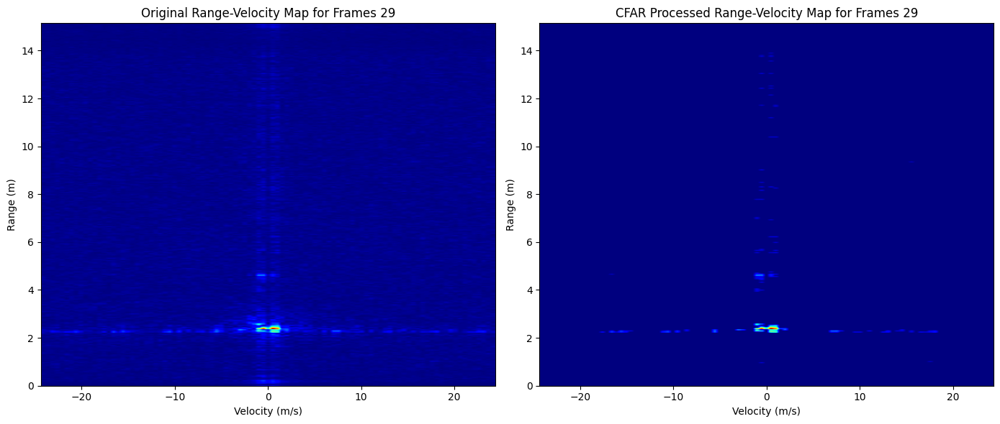

9738.221576089578


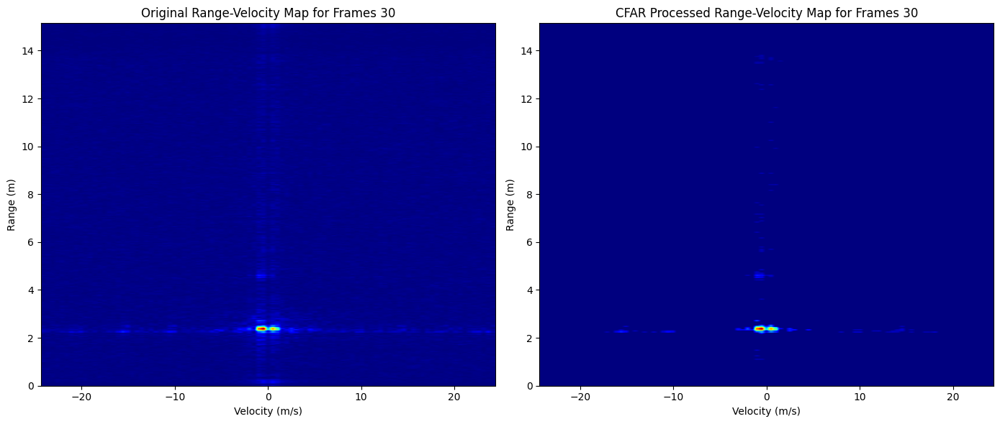

9276.108136234725


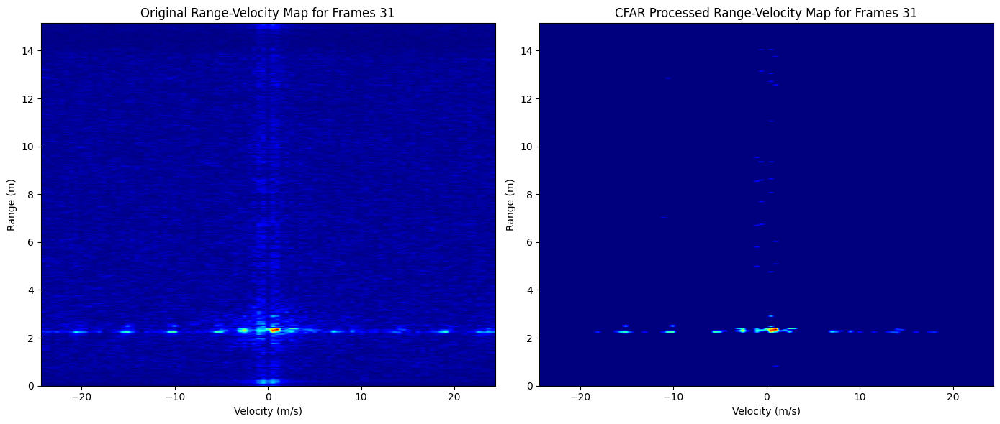

9401.908890148457


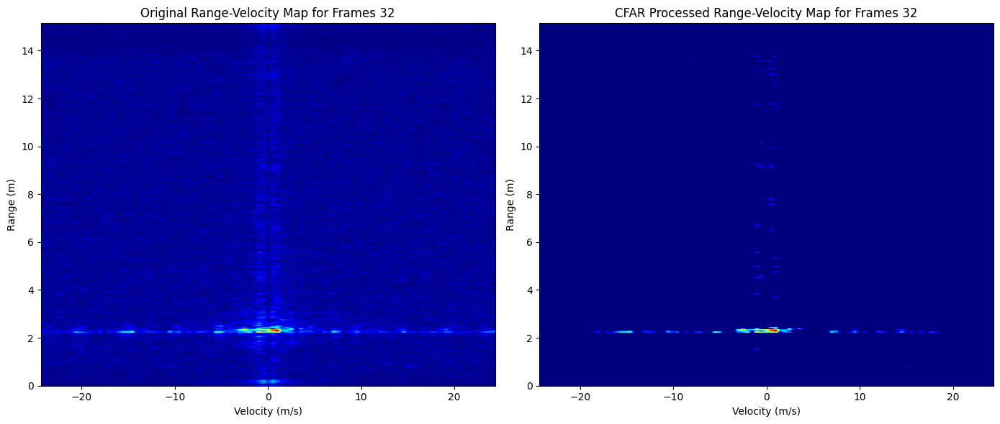

9669.982136810018


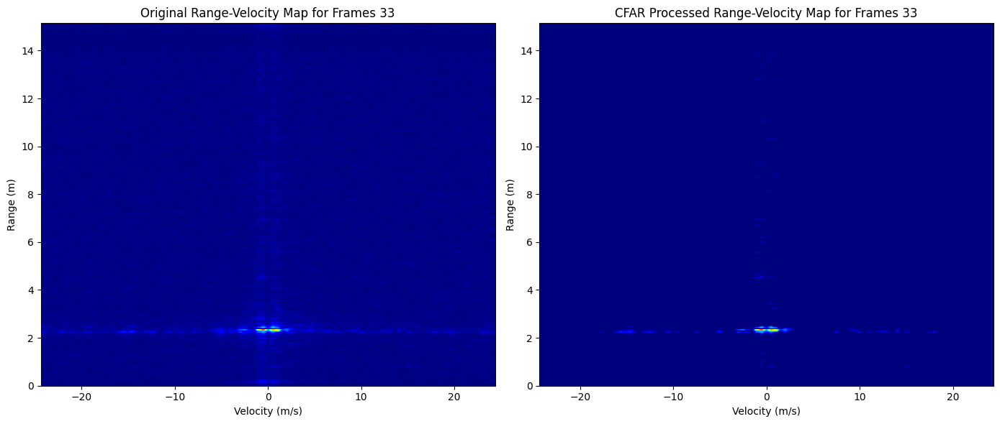

11470.080616484012


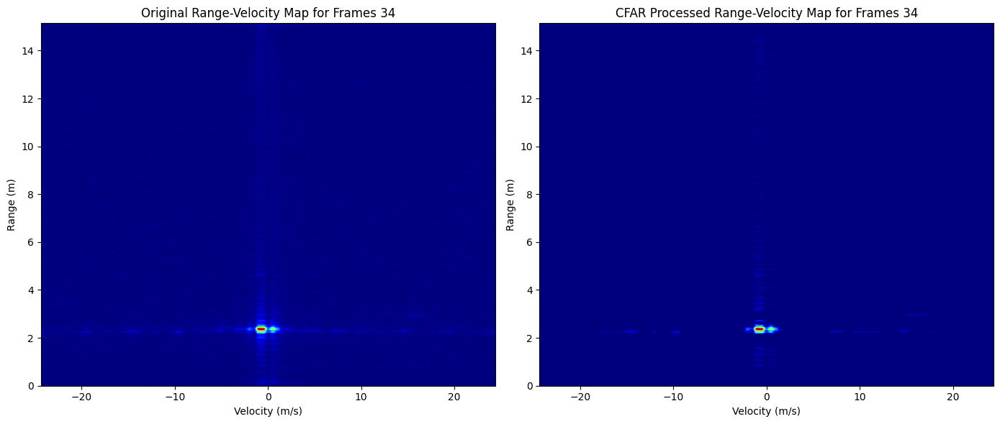

9778.871556990605


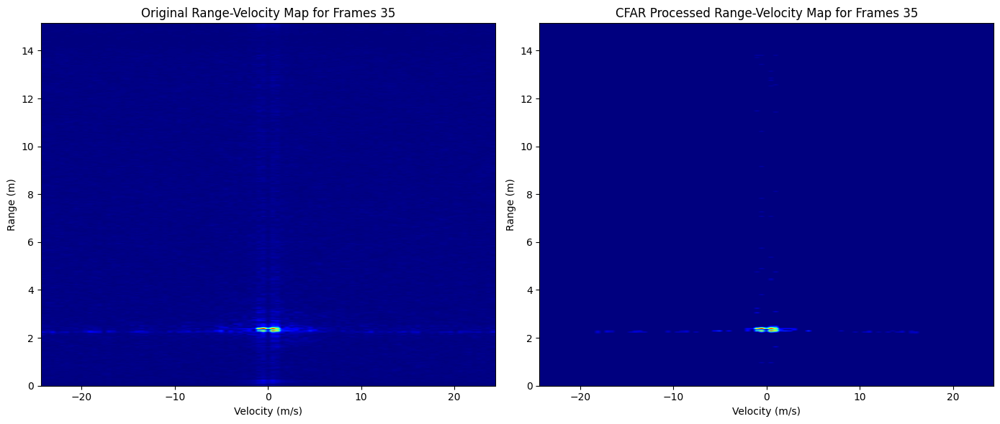

18857.00254720483


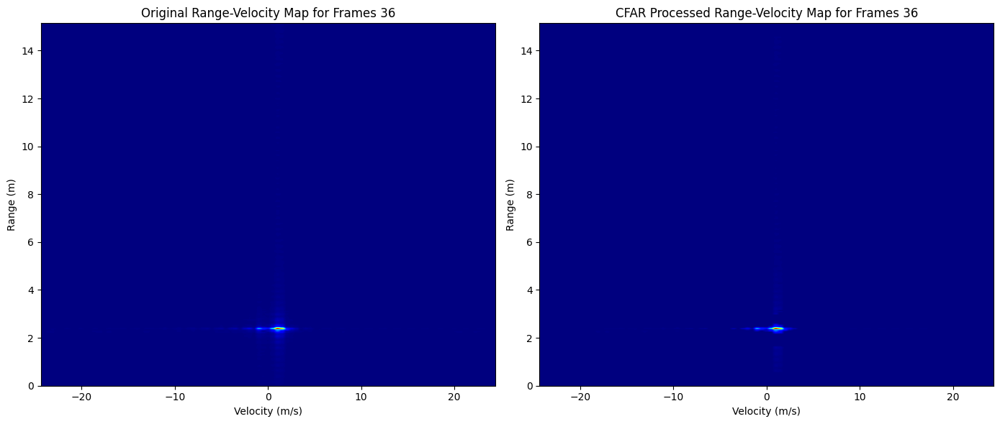

19191.37683433174


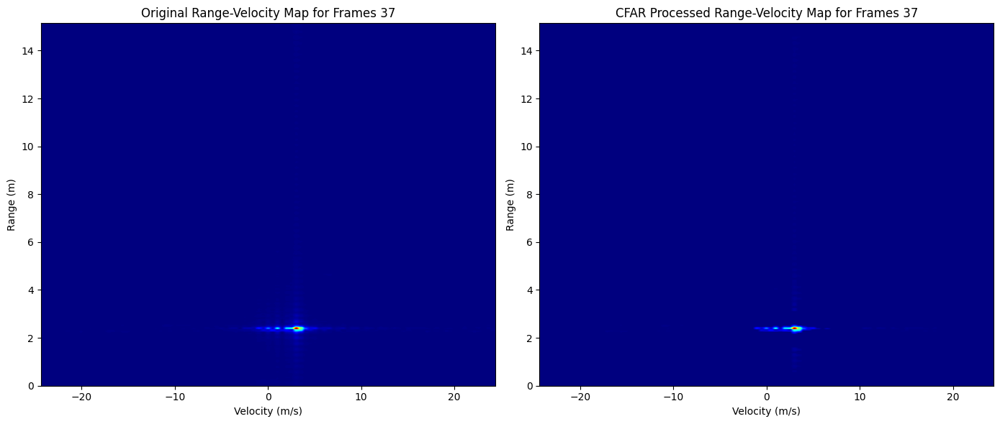

21126.799215619812


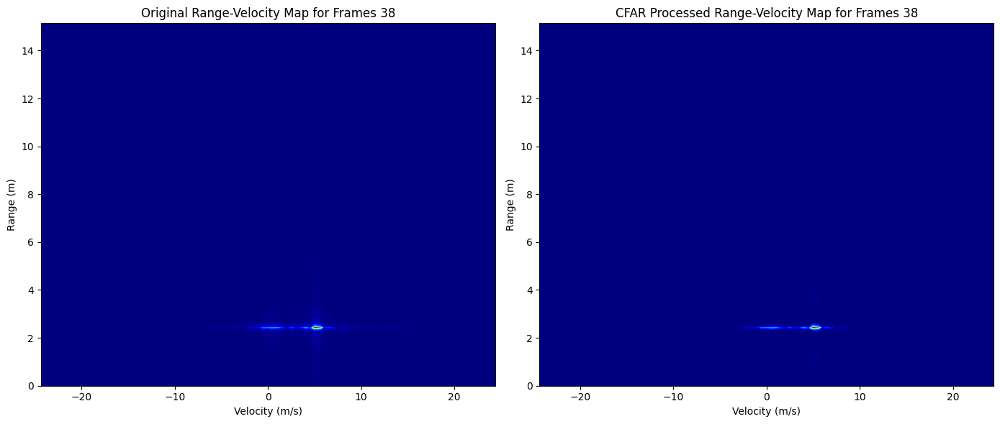

22534.823045080706


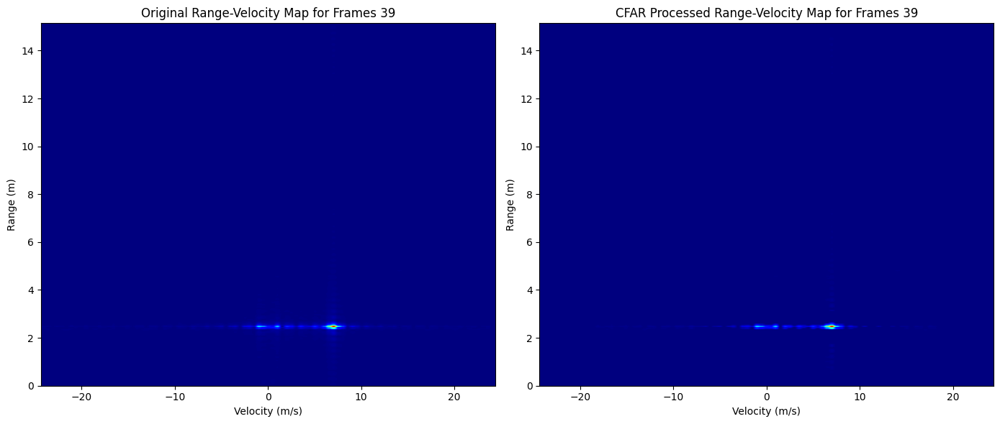

22846.046995352524


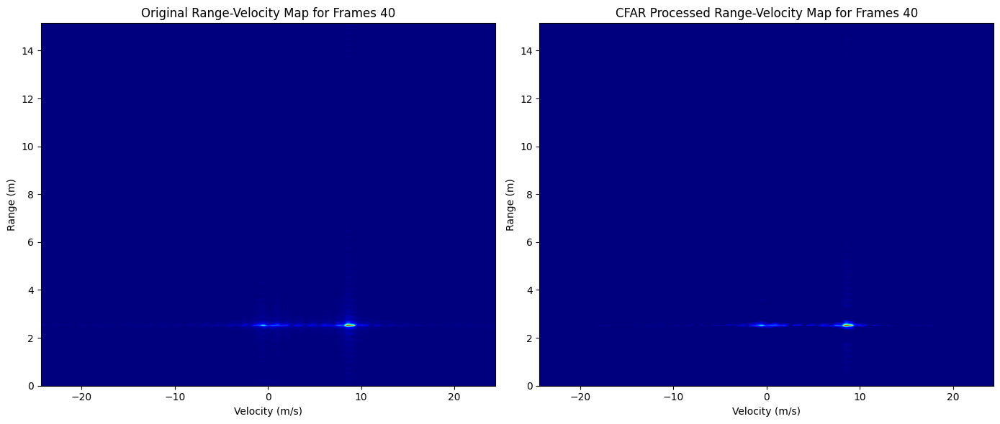

21556.687855949745


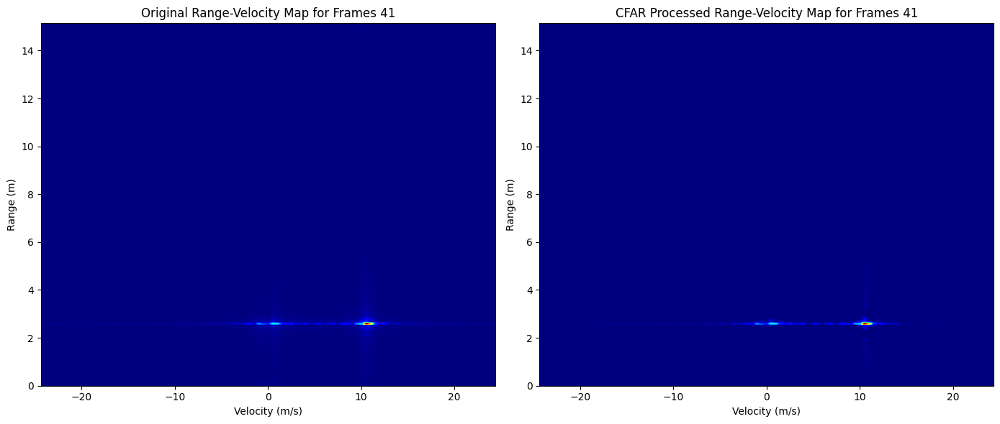

20699.23889531206


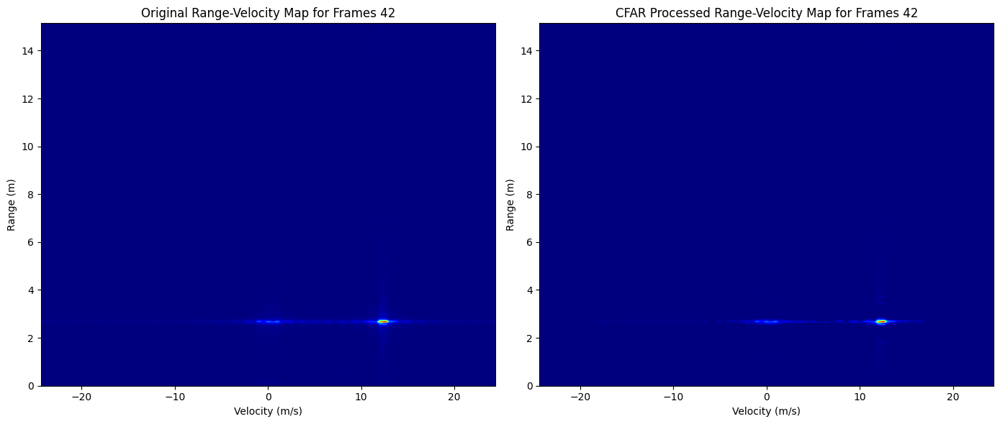

21137.1315163118


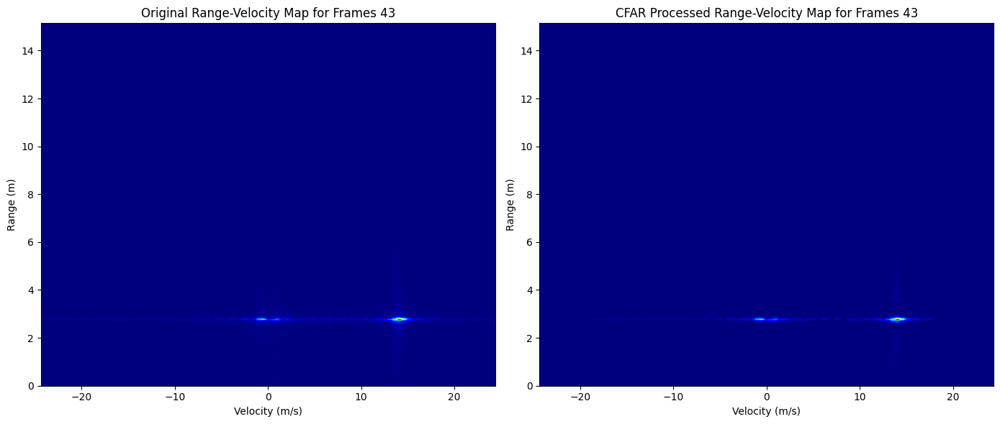

19142.841504046806


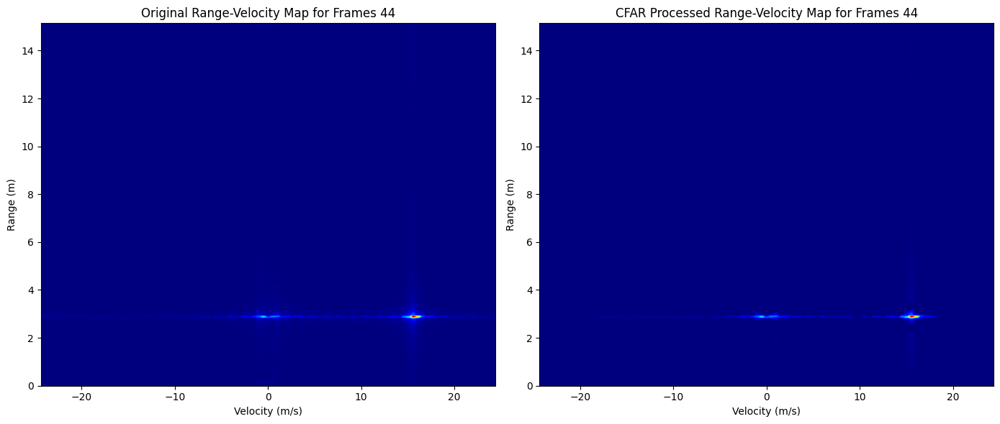

15829.713569836782


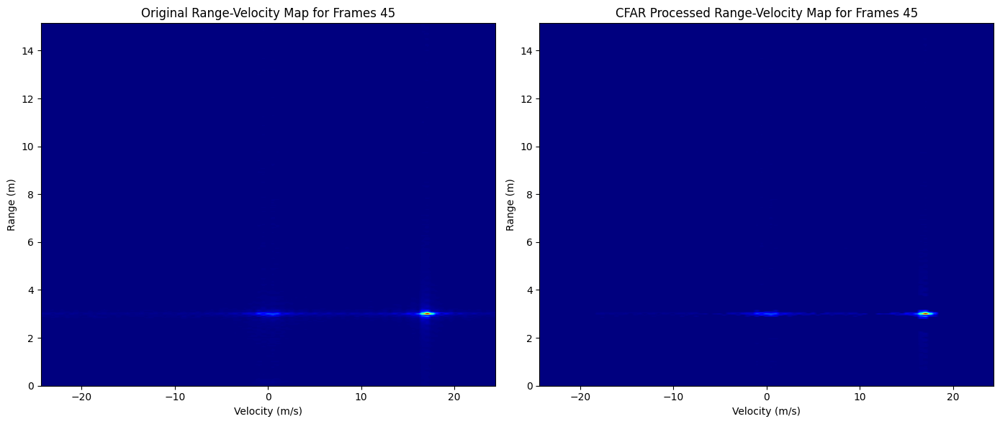

14715.165562041062


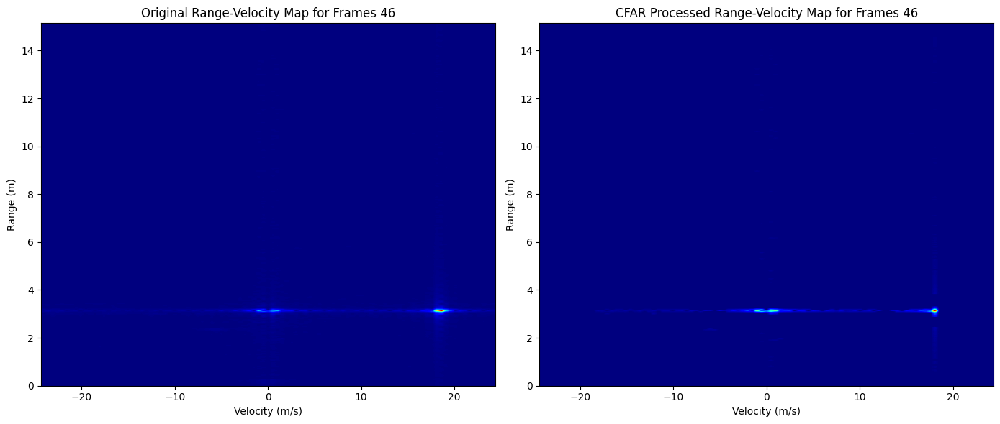

13785.019435699545


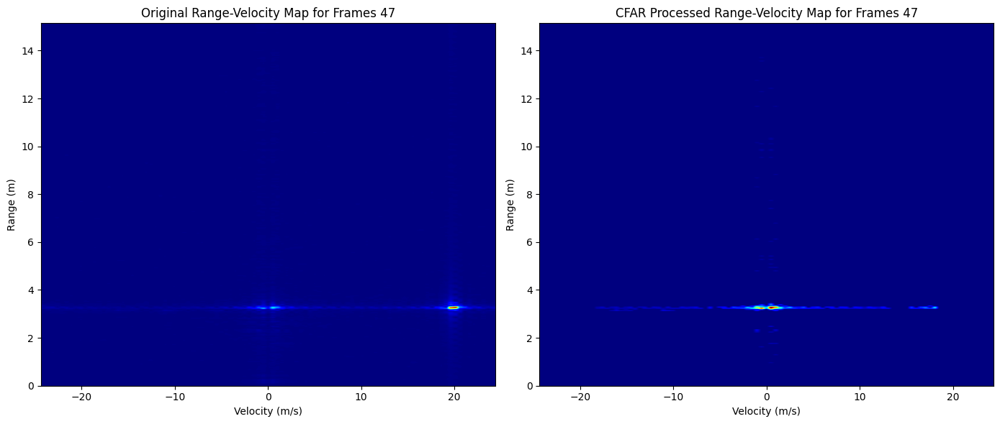

12226.381209553241


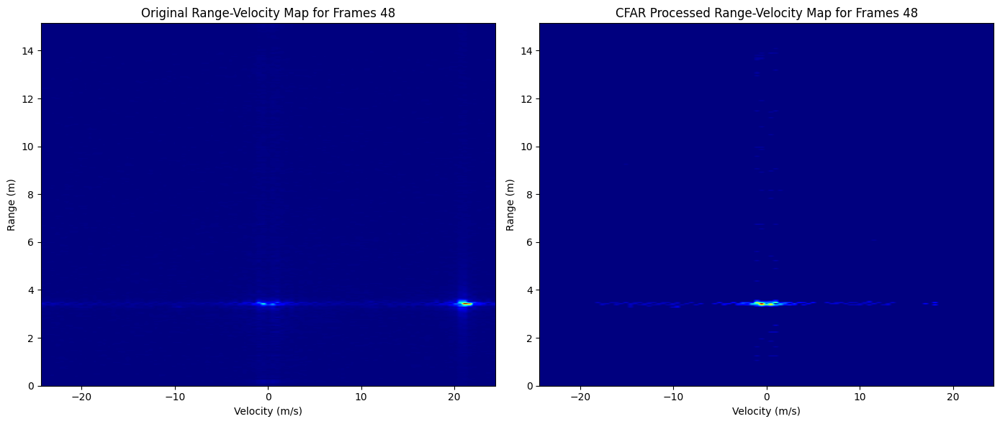

11199.672046547372


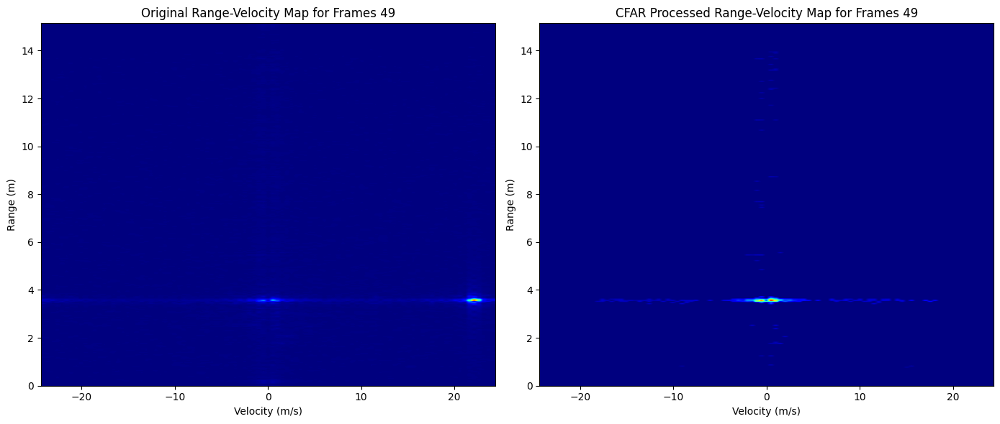

10876.045730606884


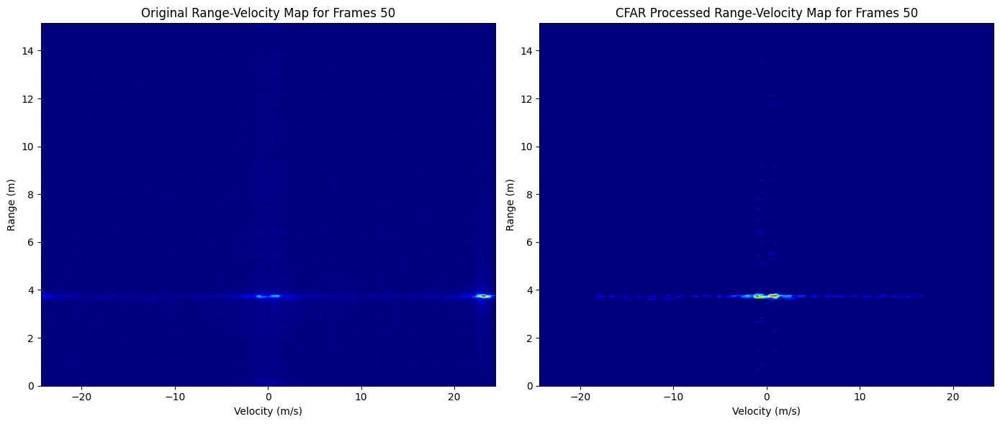

10722.125461055464


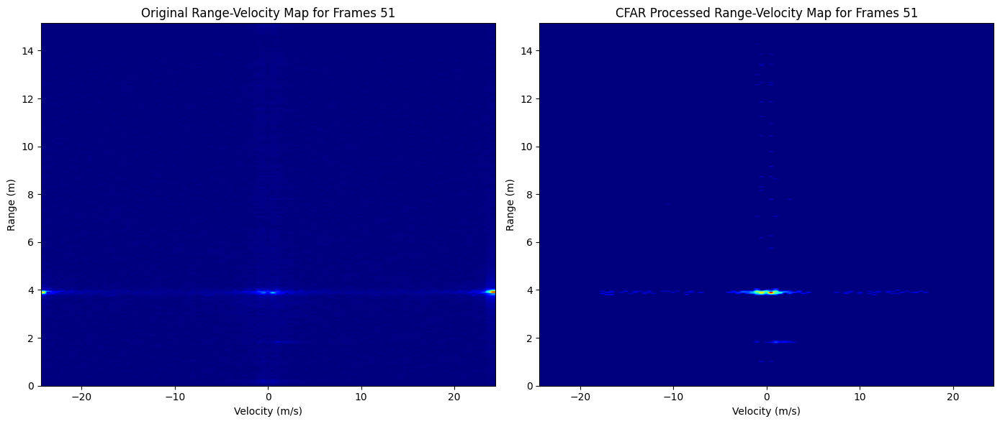

10763.696101924721


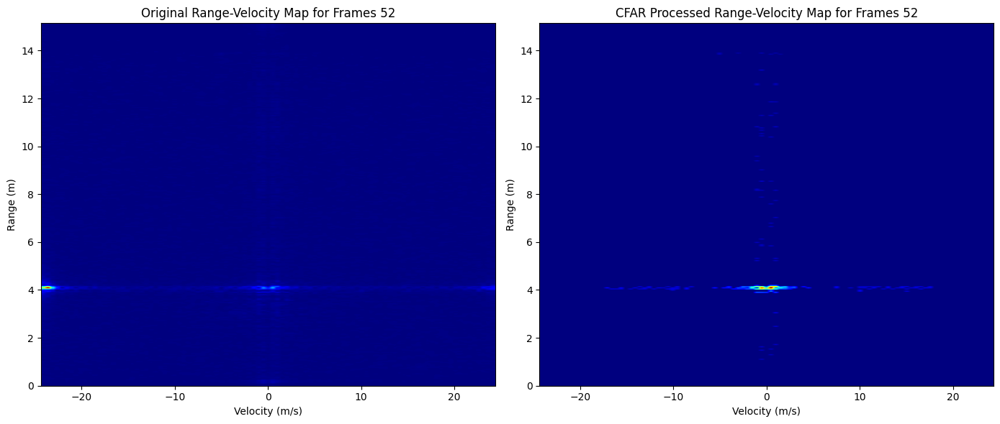

11500.804931743894


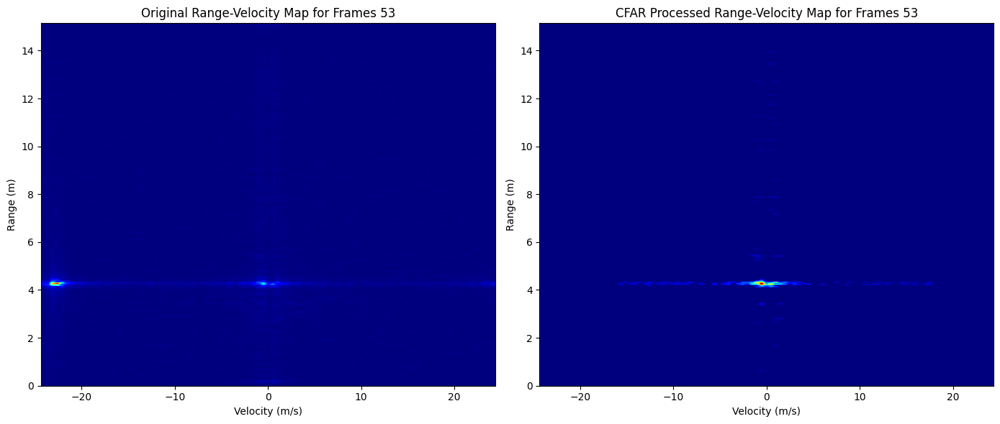

10840.393323668508


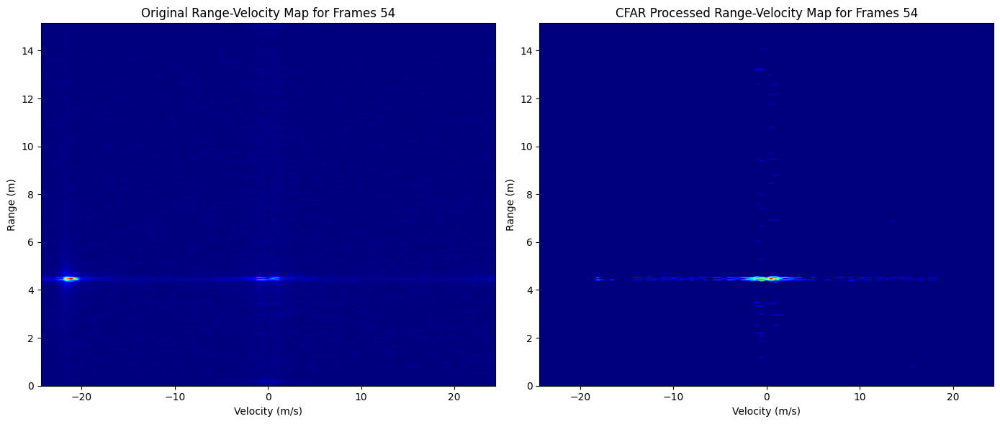

11253.477901837621


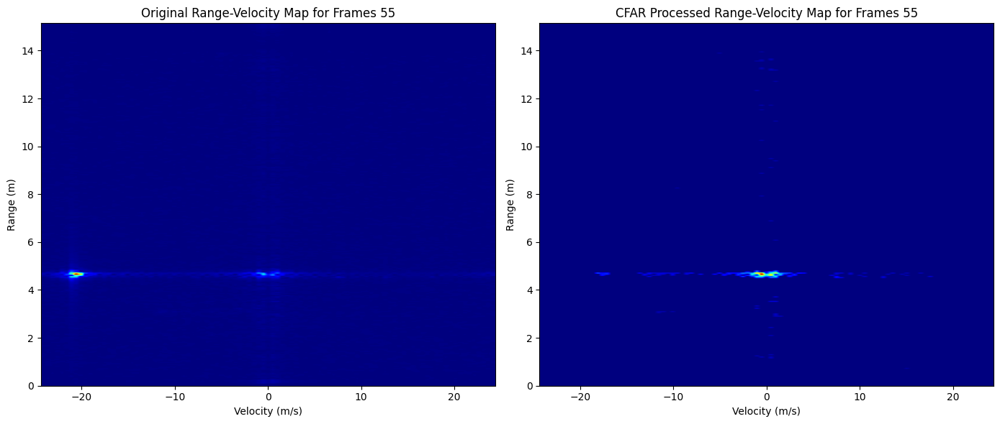

10479.314574621594


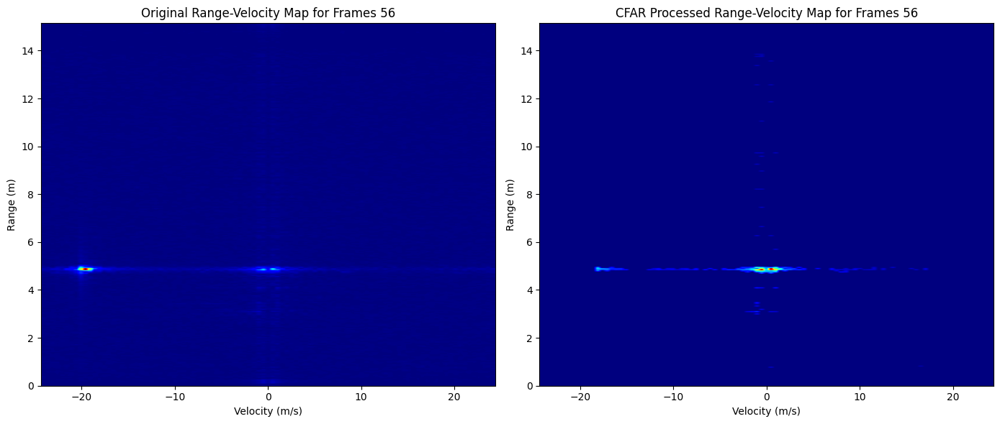

10354.354158257369


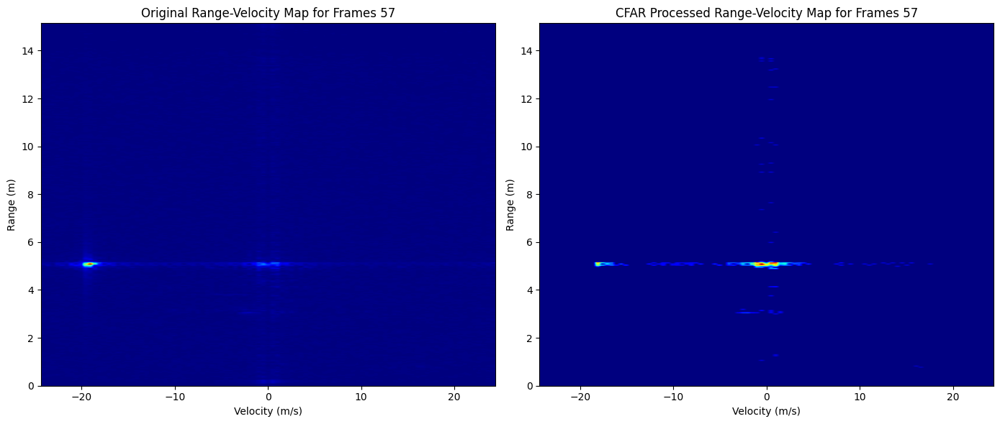

10024.17178243277


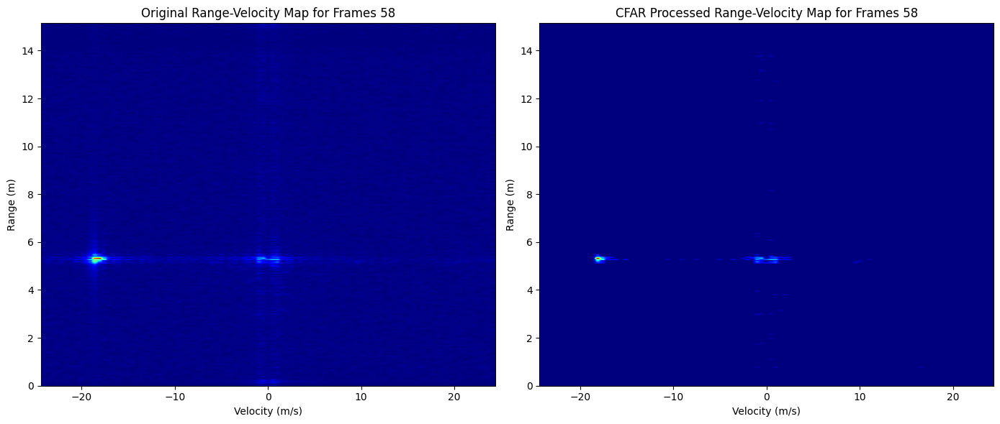

9628.046602946004


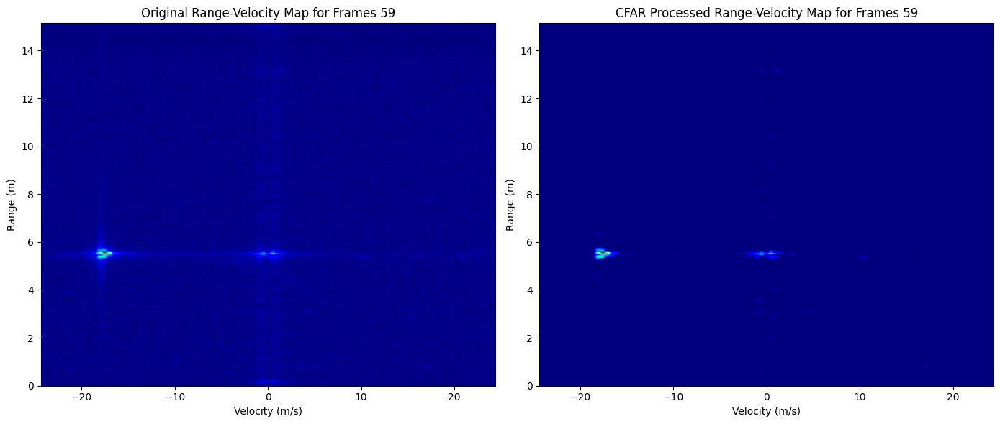

9278.638365554407


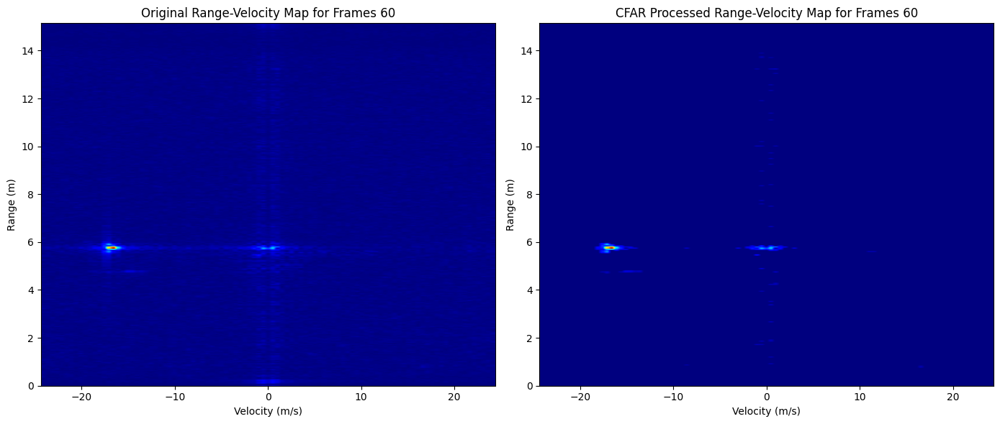

9085.737220190145


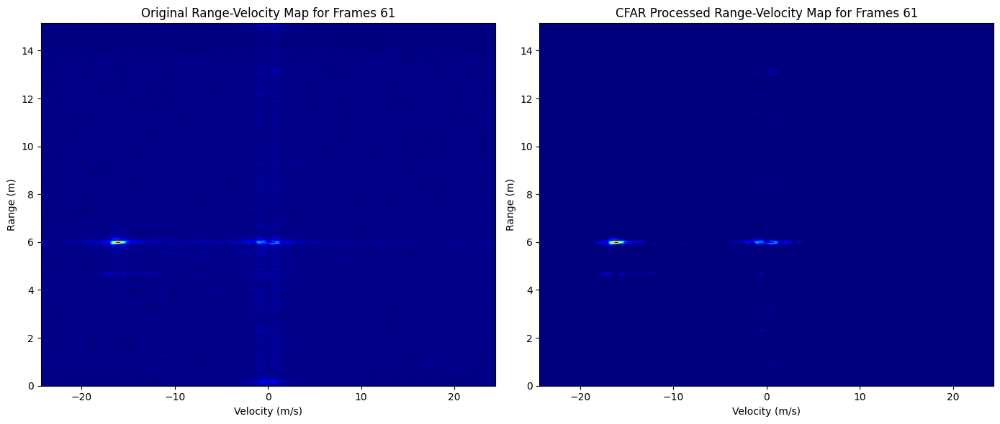

9019.93510434962


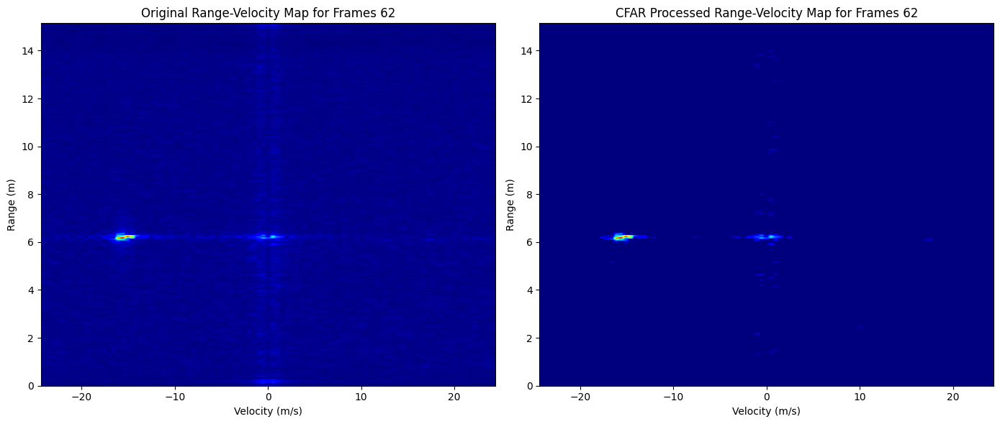

9354.598024926237


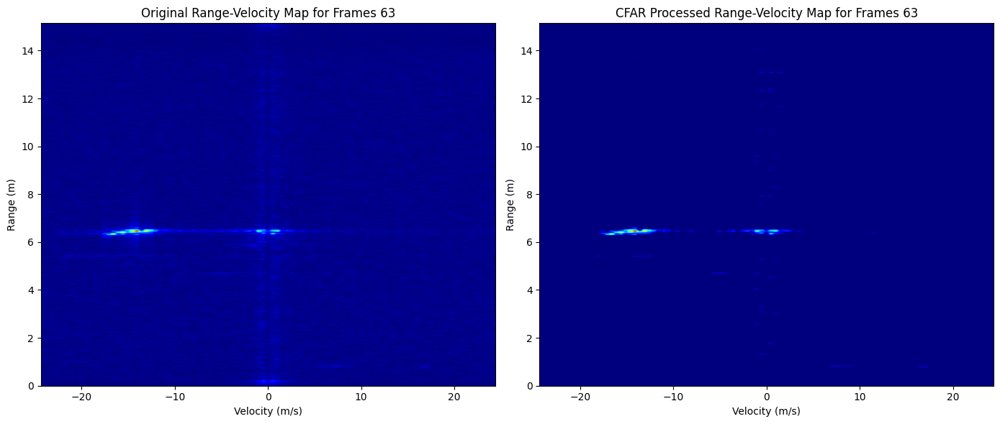

8763.511167501594


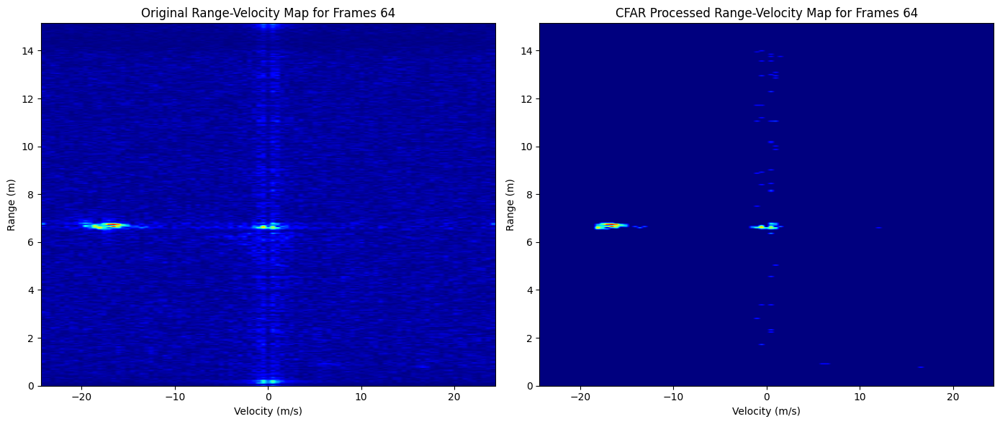

8573.329953999073


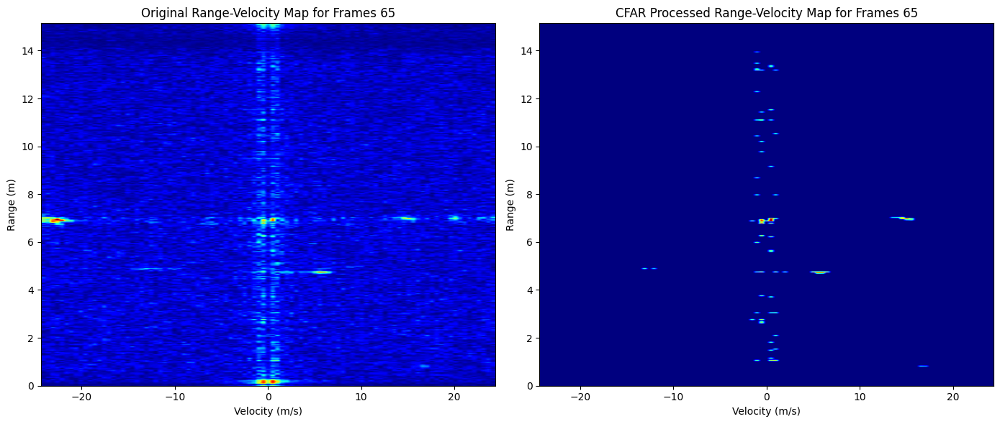

8607.06289522456


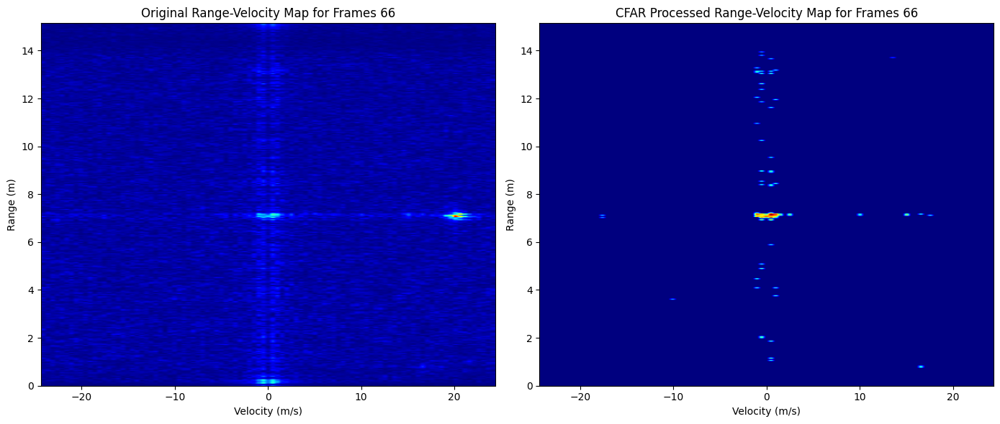

8569.784861885322


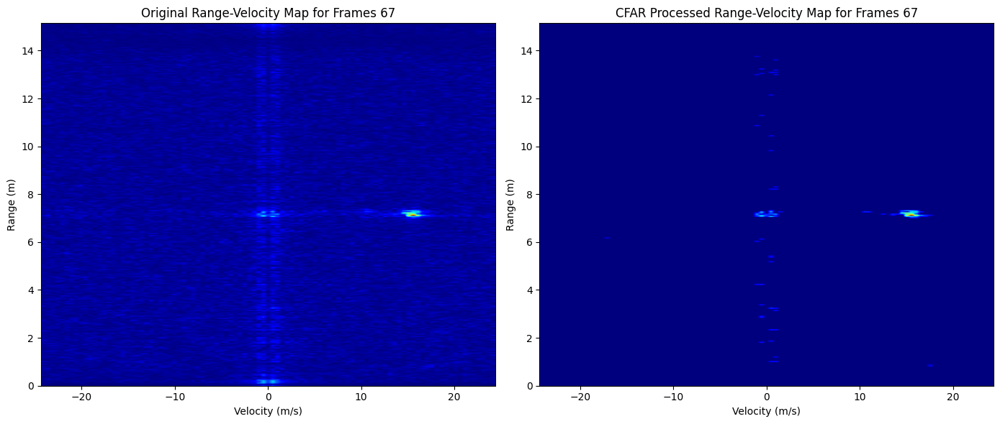

8634.665078624506


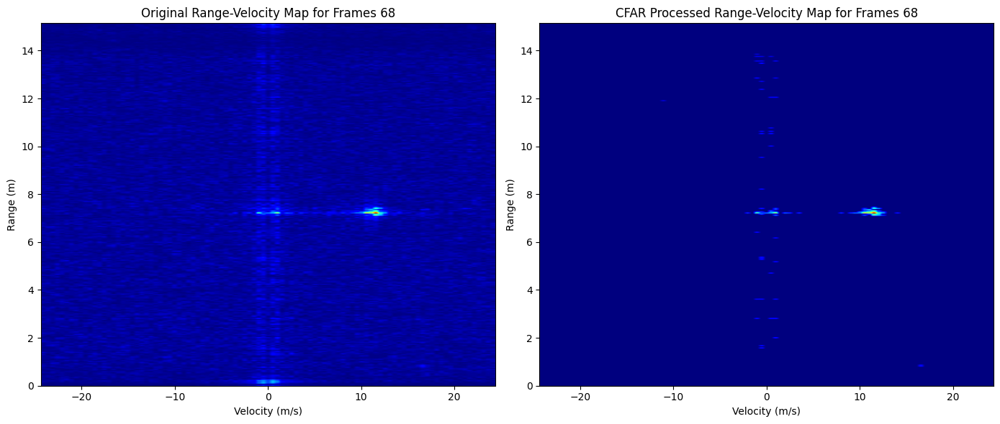

8507.220372519627


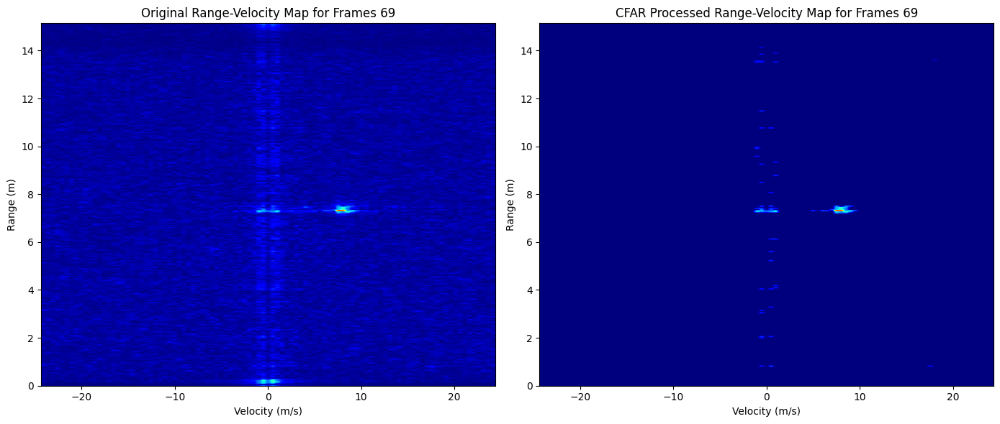

8360.277665464917


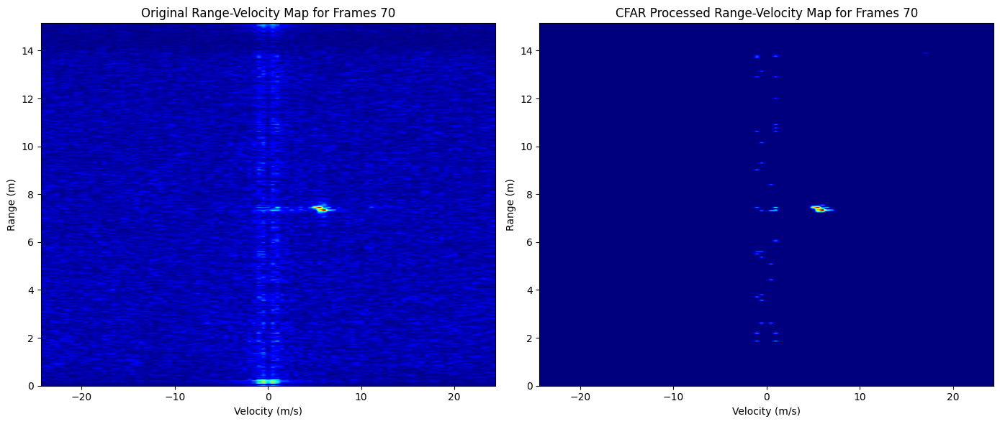

8519.186858118623


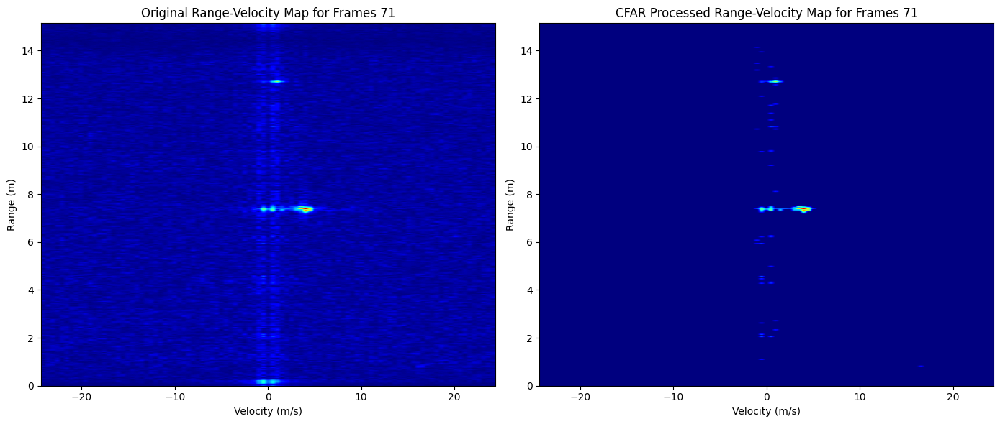

8589.471818281143


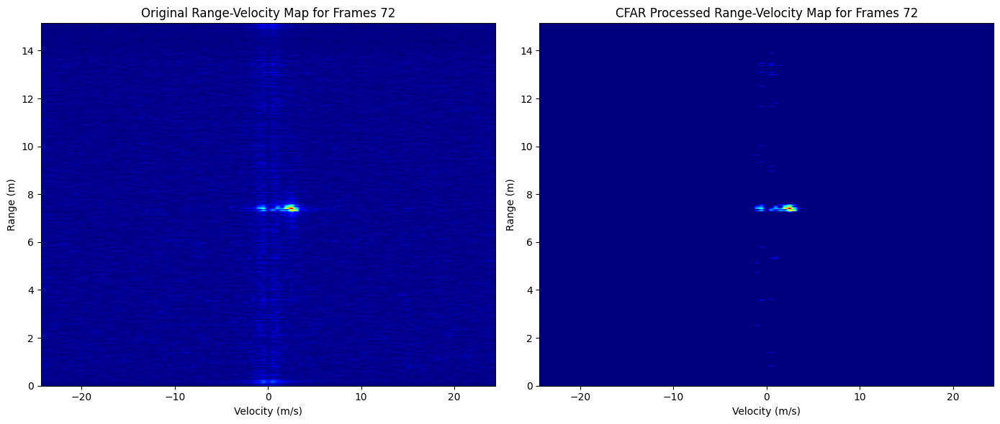

8564.665508133101


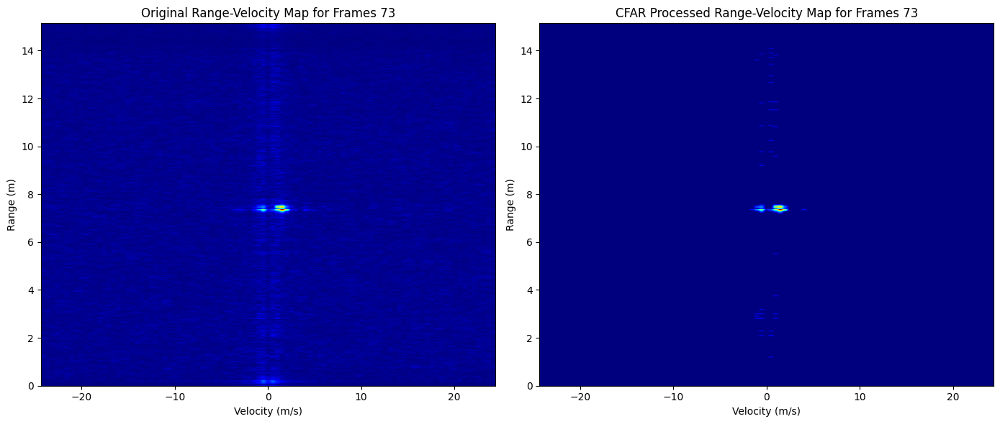

8334.629978136301


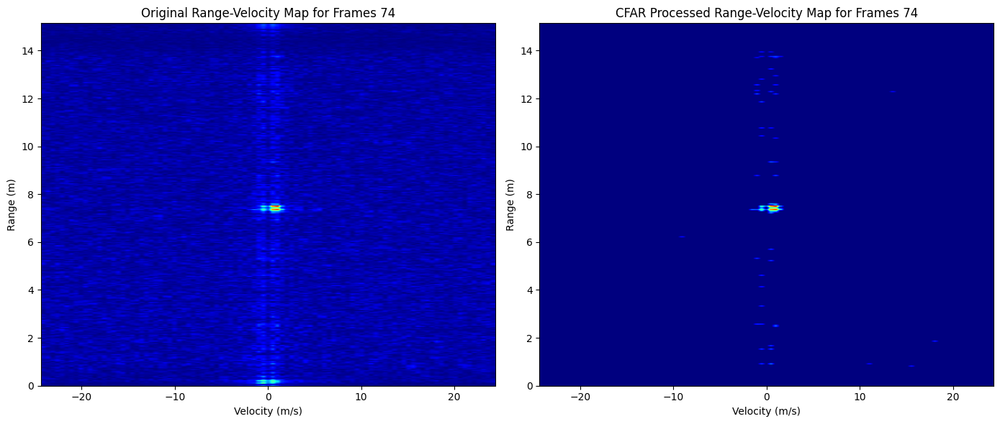

8292.588958748132


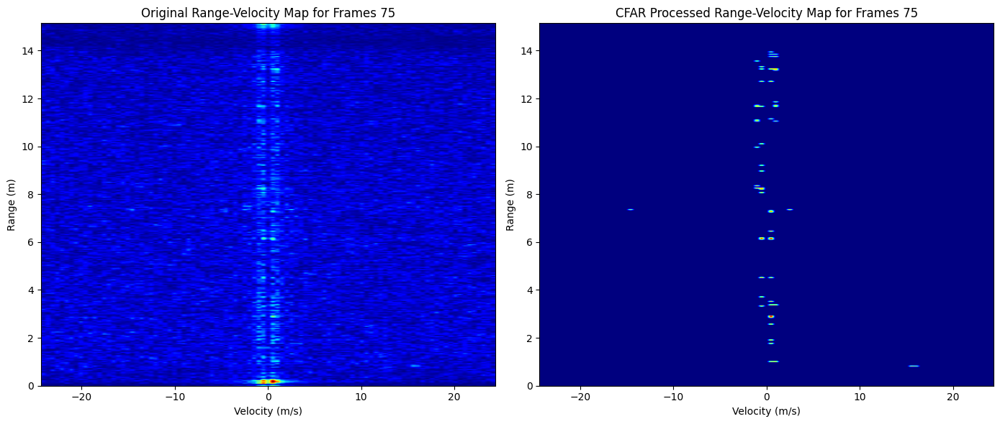

8418.460151931813


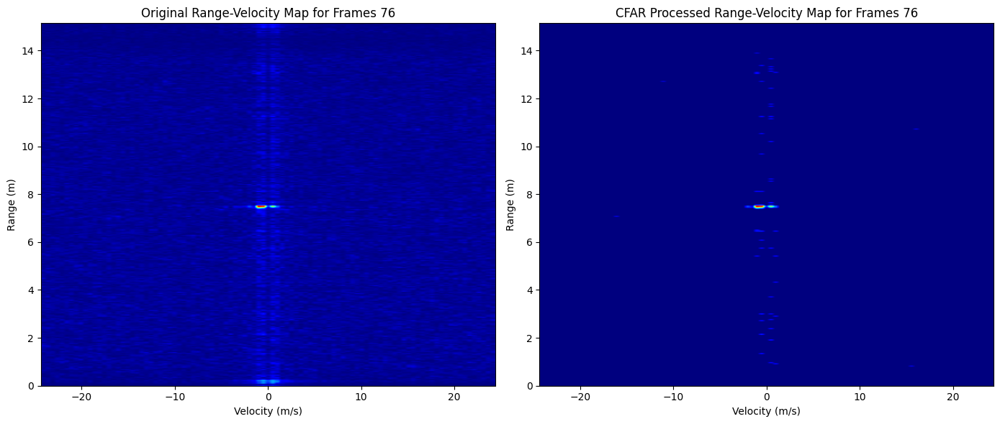

8543.779993198863


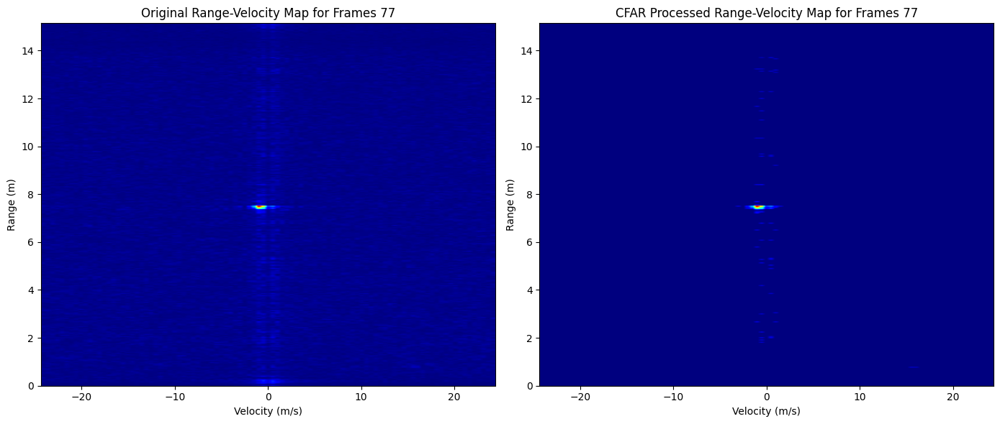

8663.619168344636


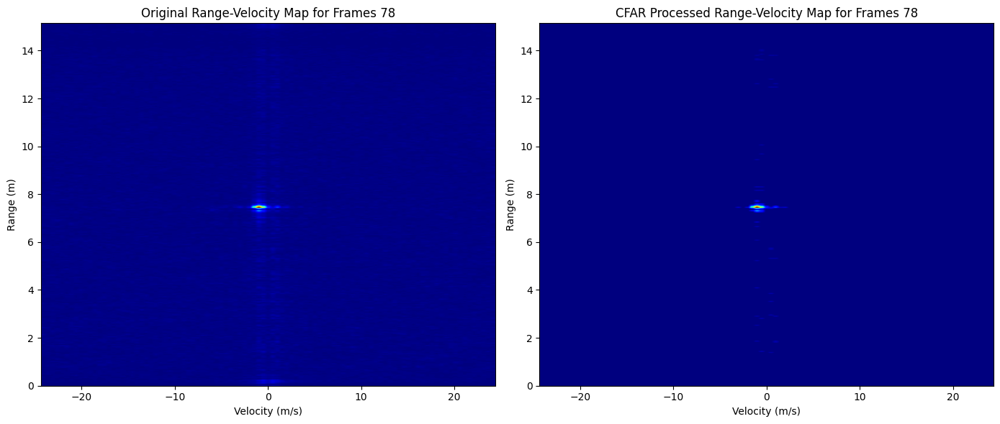

8684.606553652899


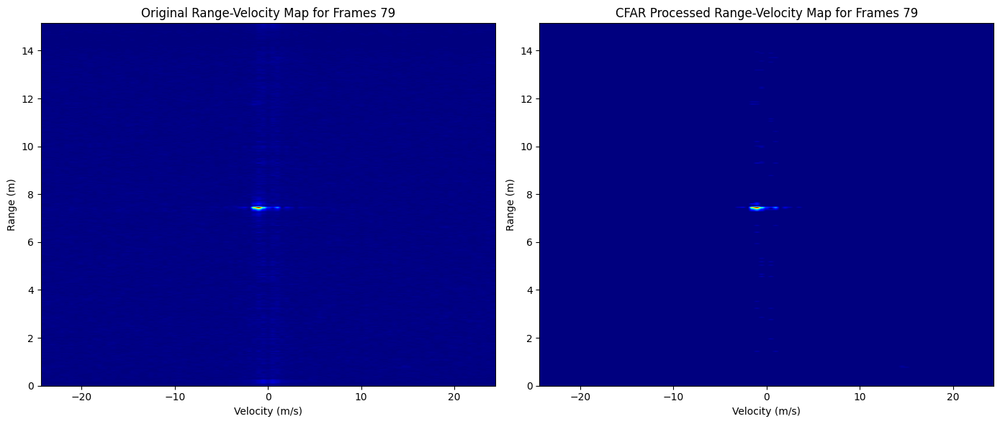

8445.17870025137


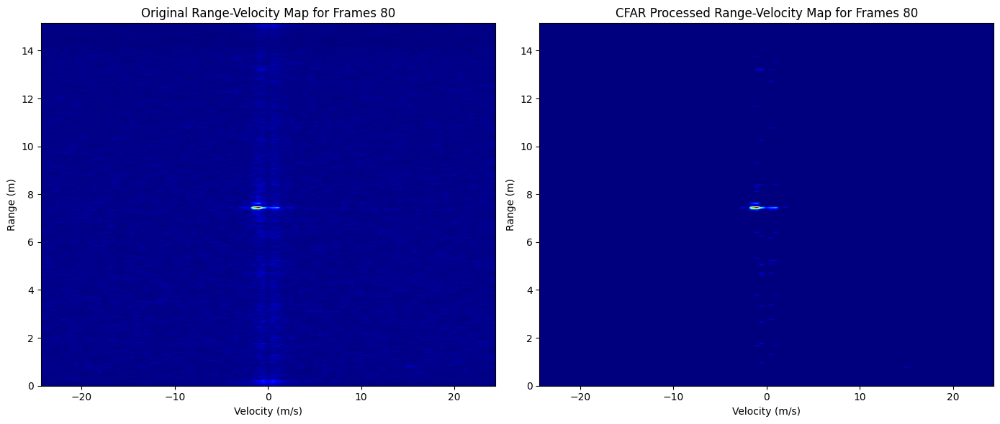

8536.665499863839


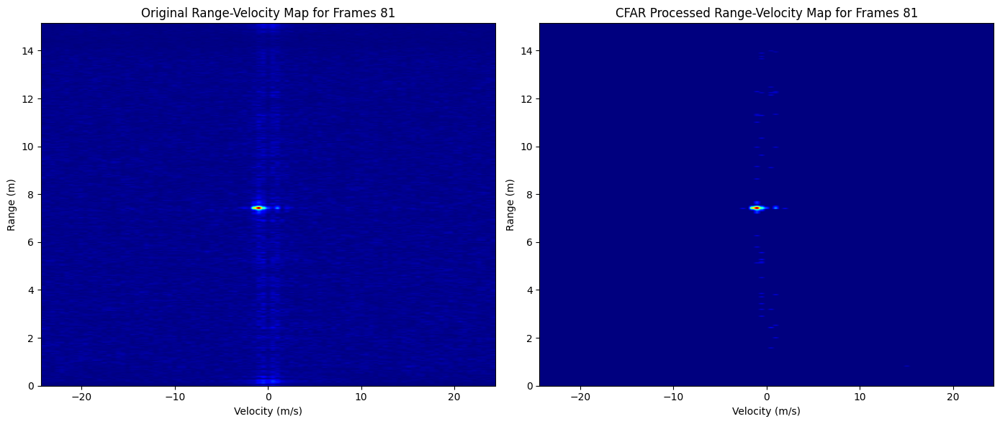

8533.740639869613


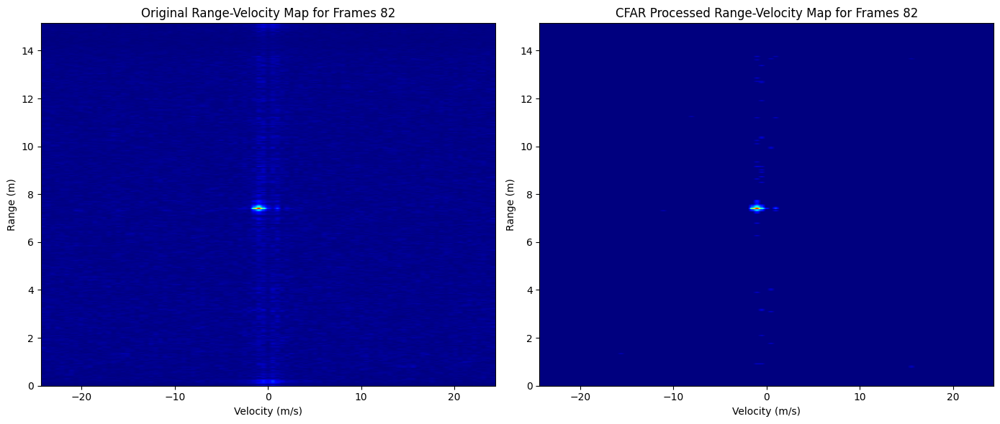

8483.827445161496


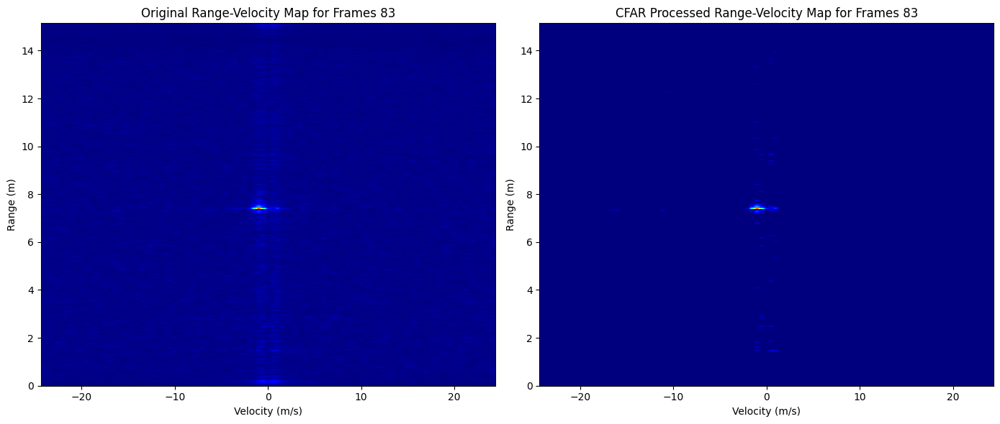

8515.195802263002


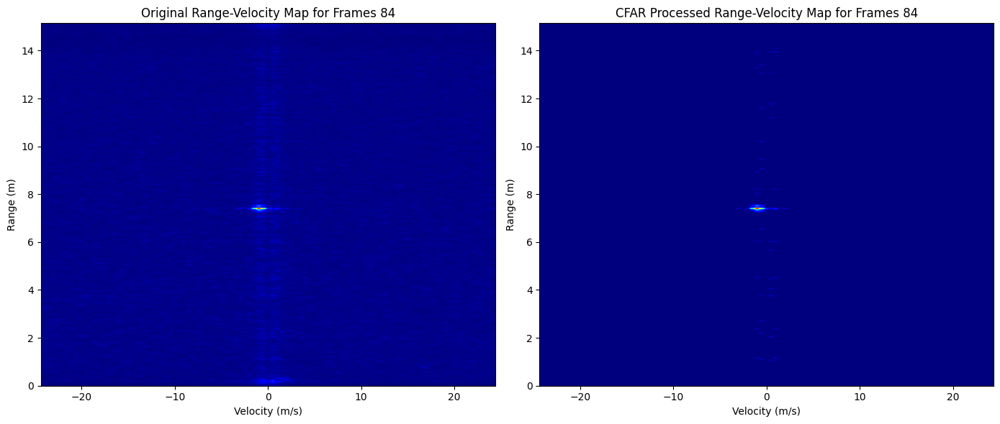

8618.21273379894


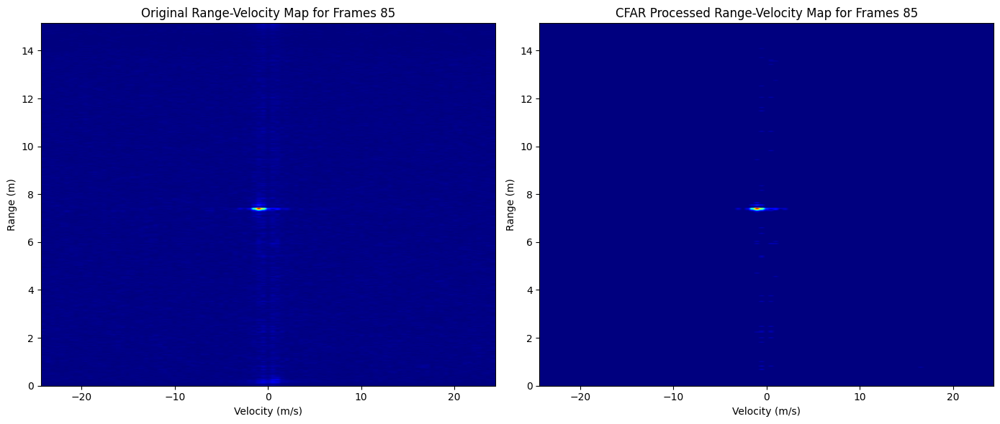

8542.764565981006


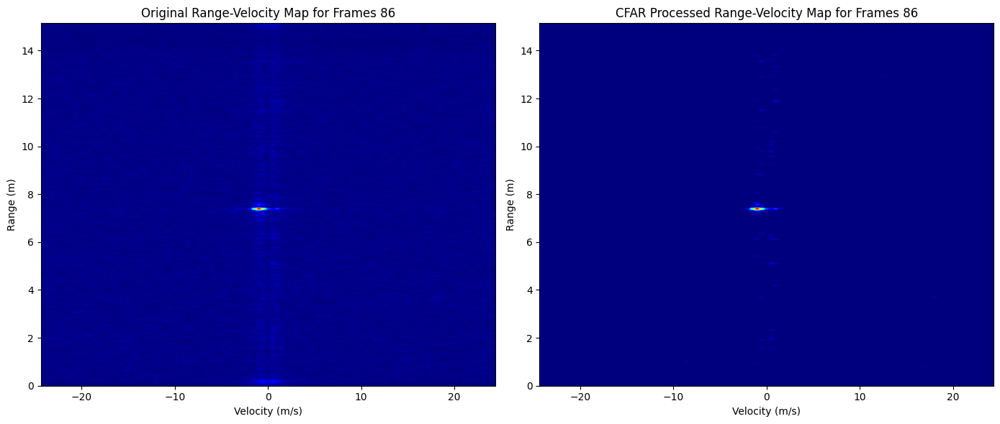

8522.767761609686


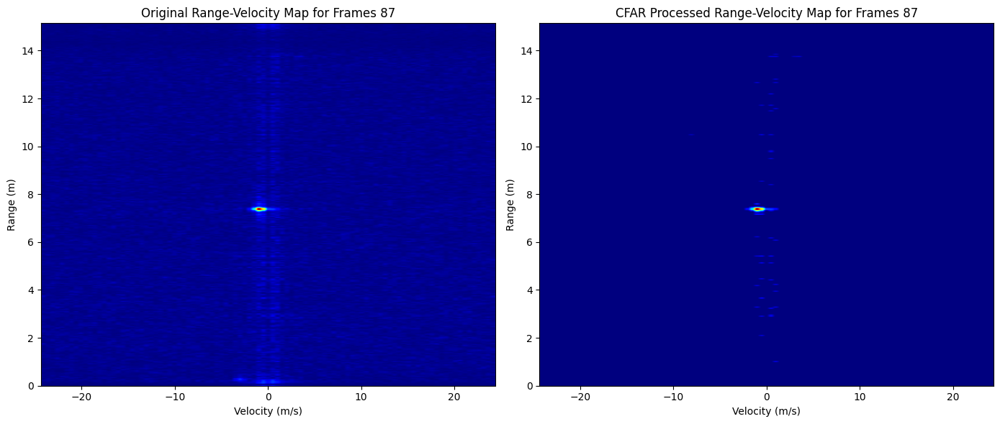

8387.961544251879


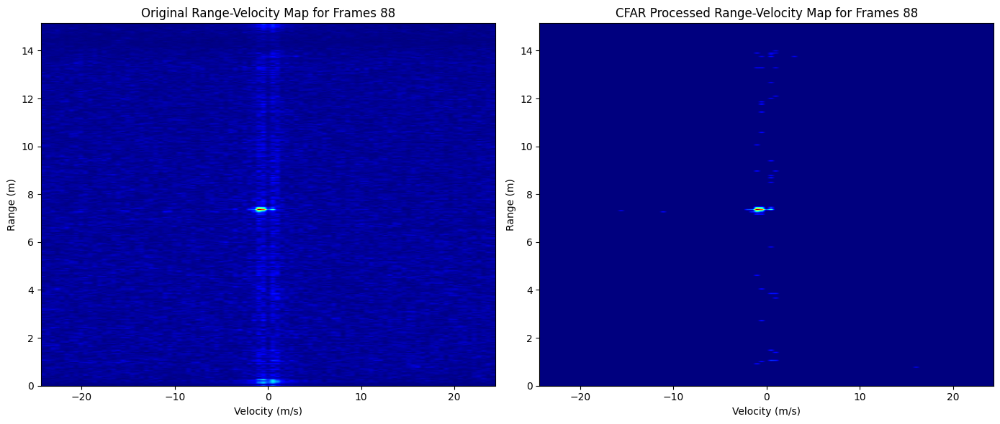

8394.624383918646


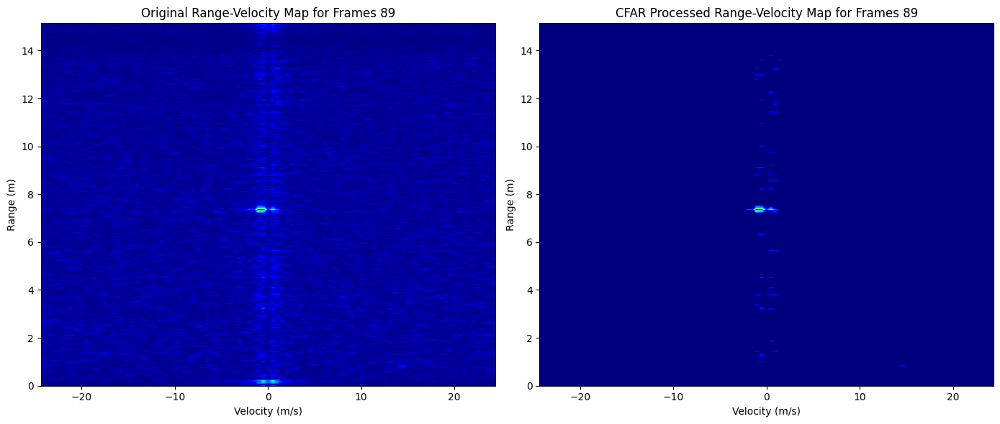

8408.617294592535


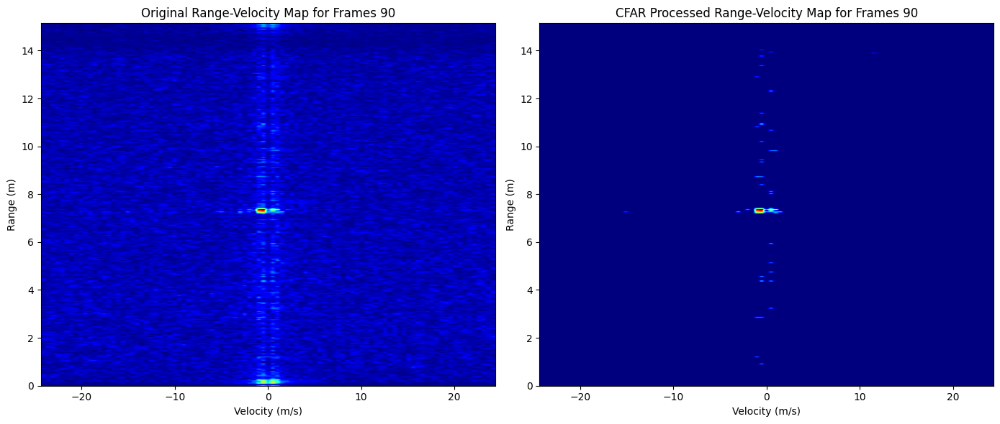

8510.095758655407


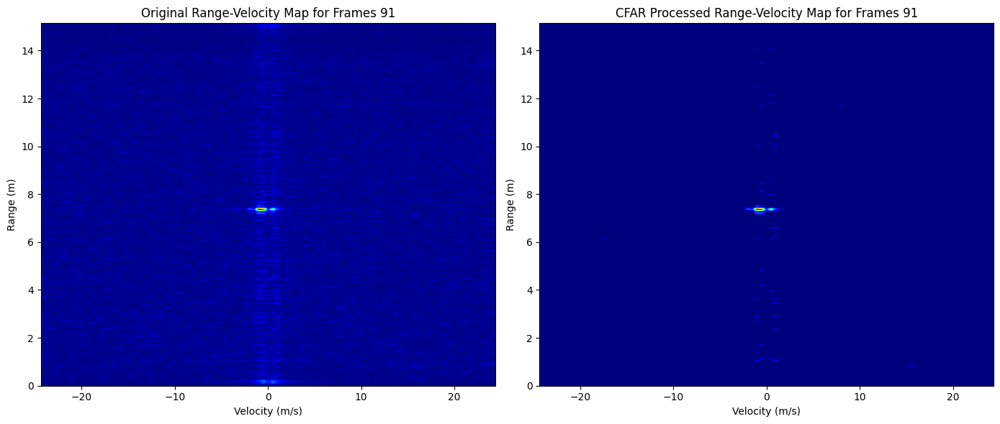

8536.641262480829


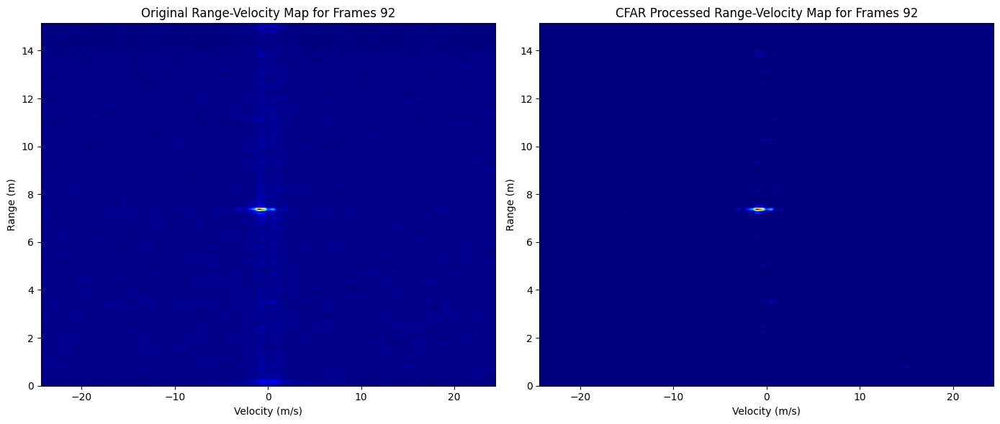

8499.393382179951


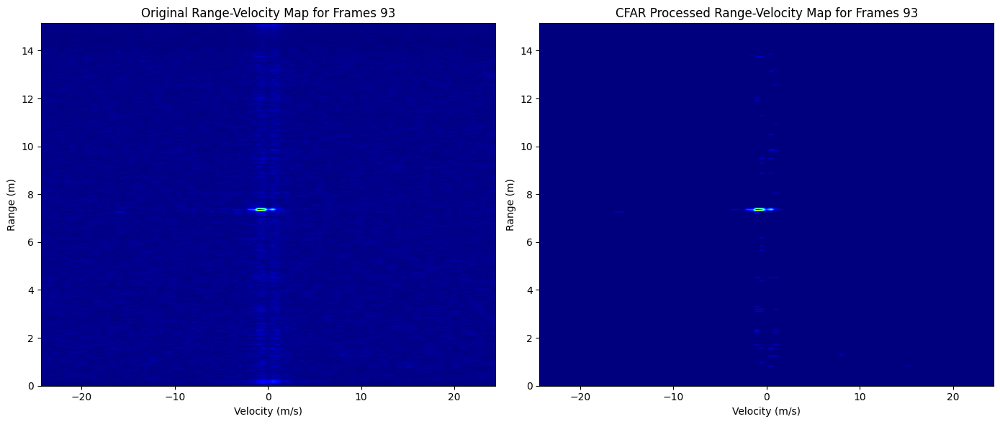

8600.378066215597


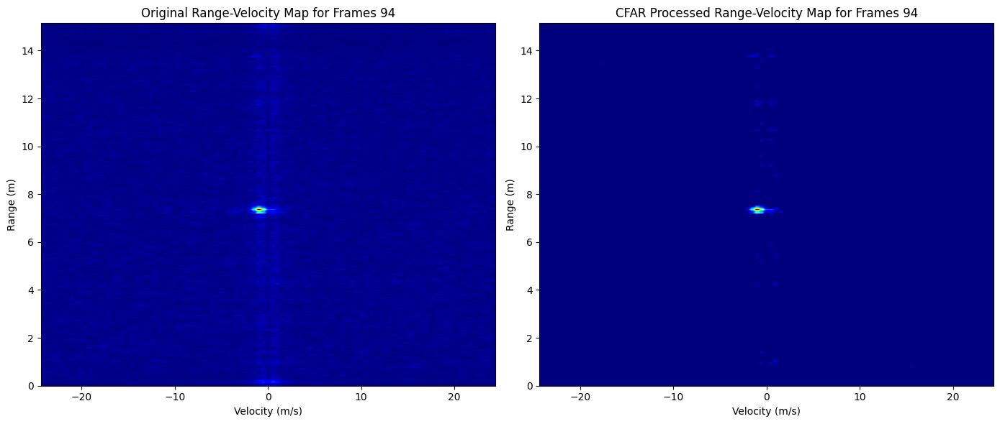

8621.159924922795


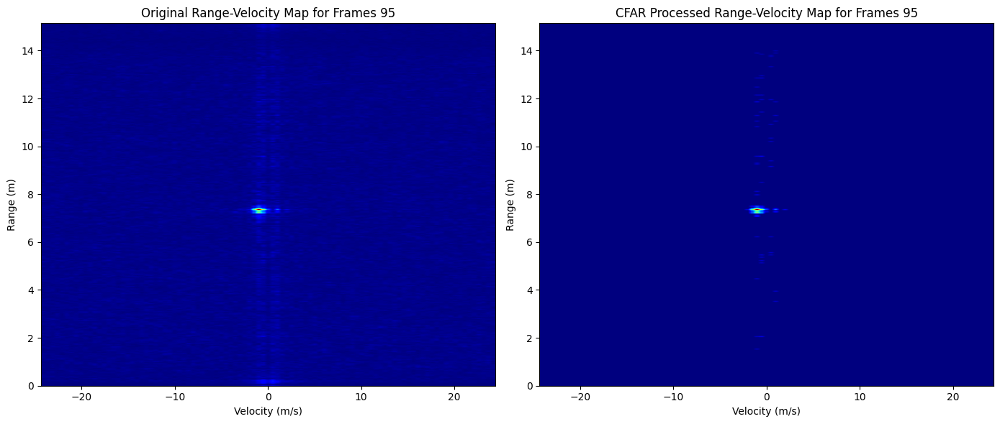

8480.733493914324


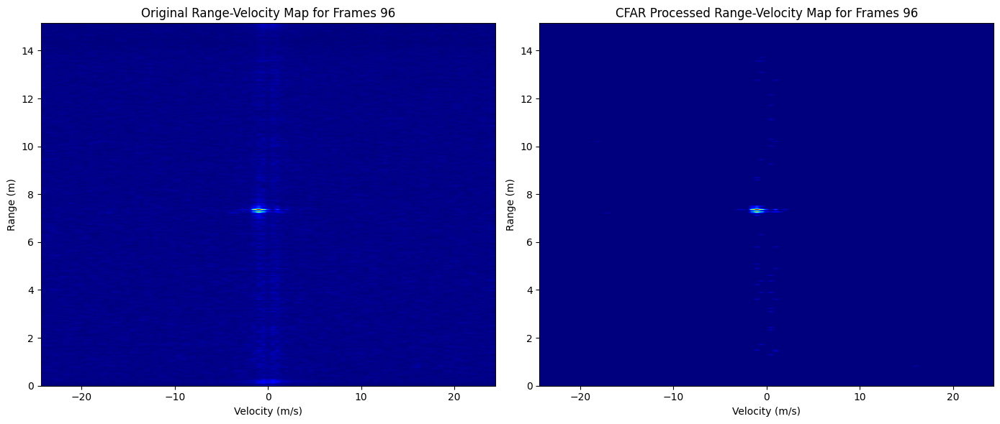

8697.379723817141


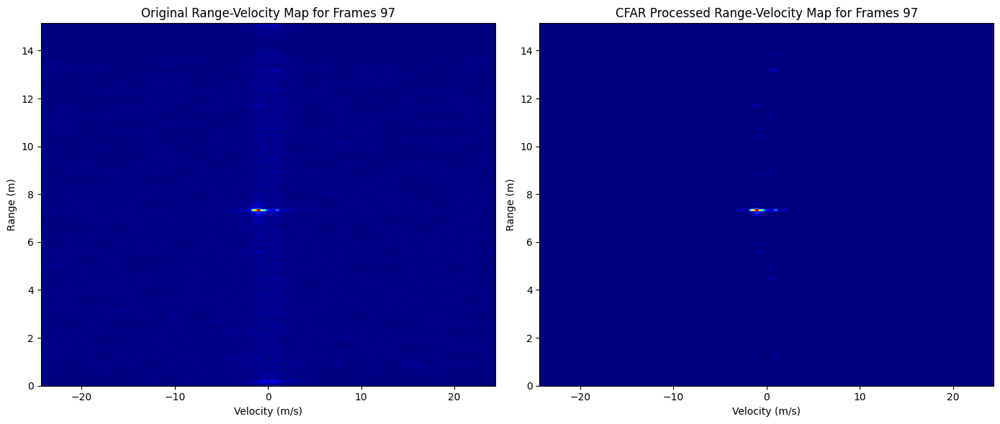

8528.335148967295


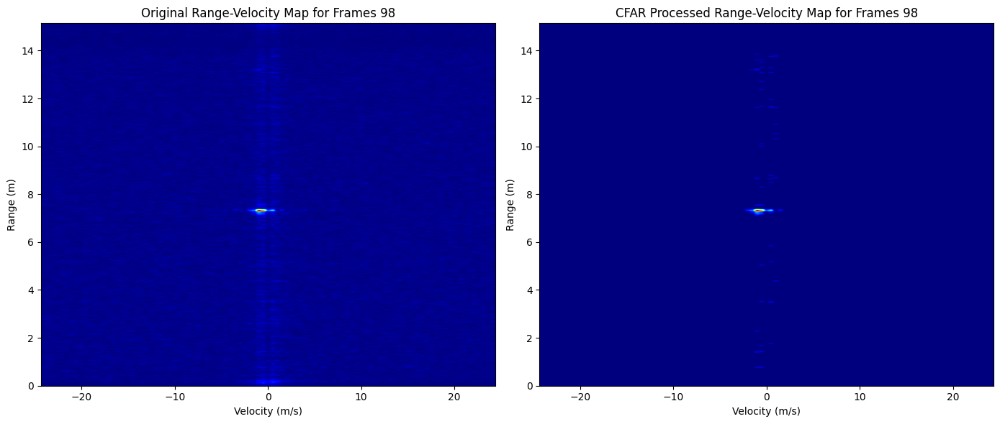

8515.524981739478


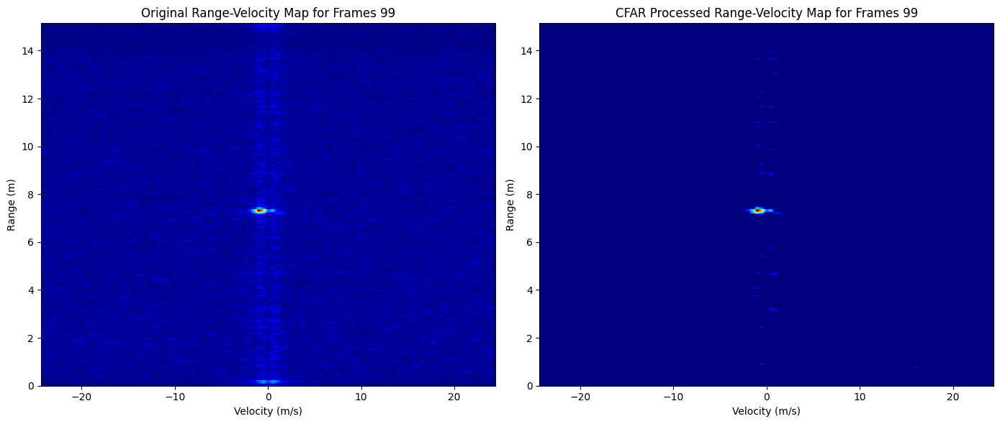

8530.496384842838


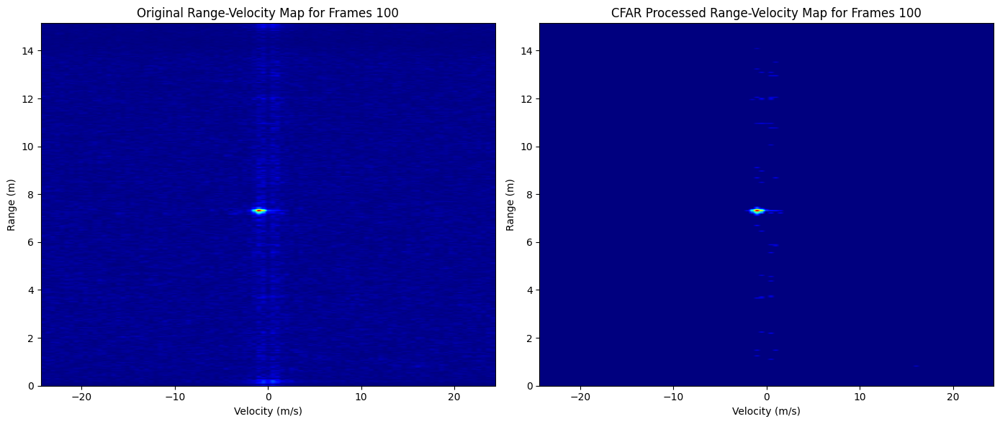

8674.300231230915


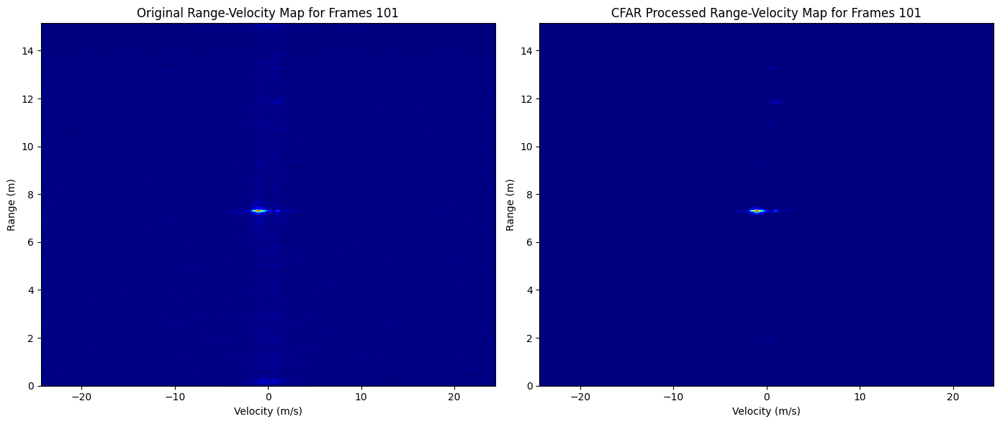

8487.05114826305


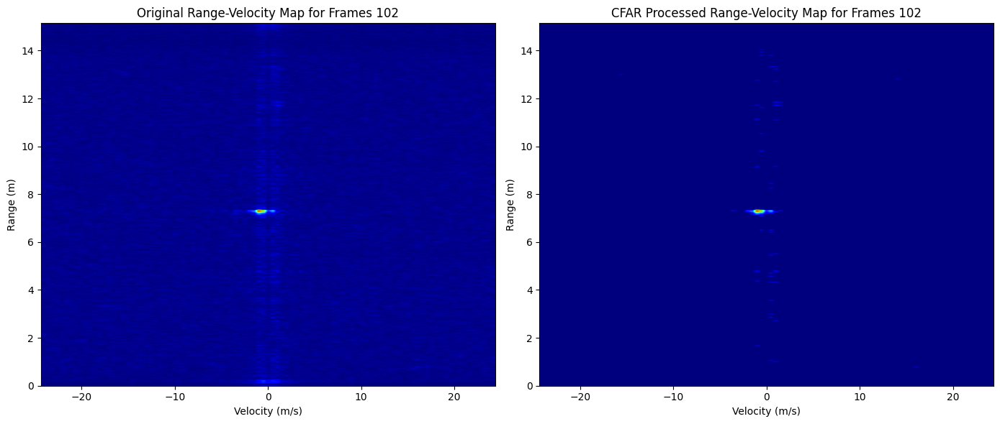

8475.99101464722


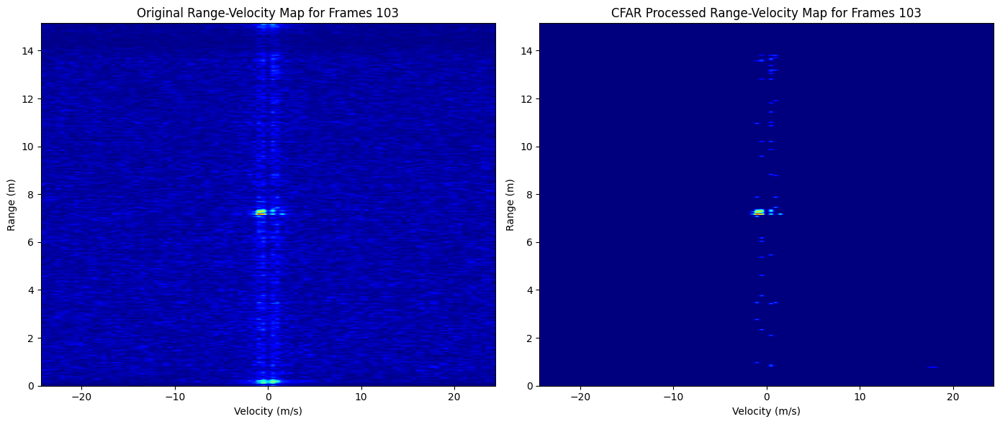

8454.234280925797


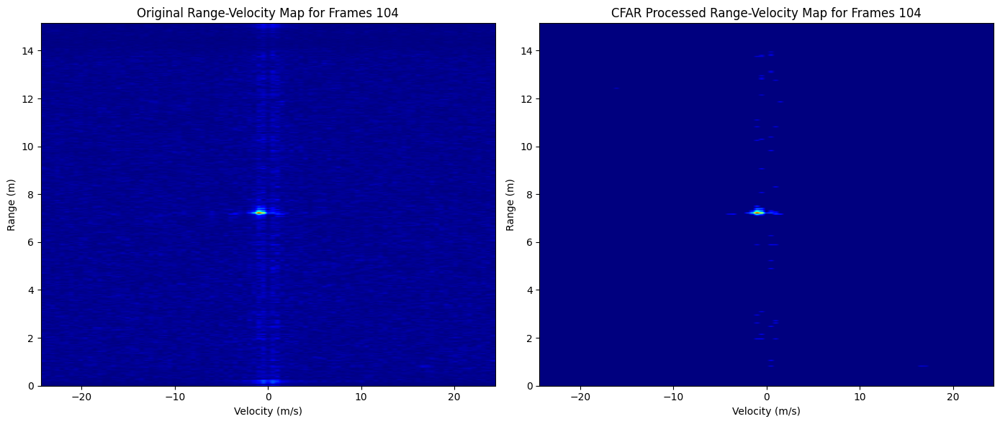

8509.927792654473


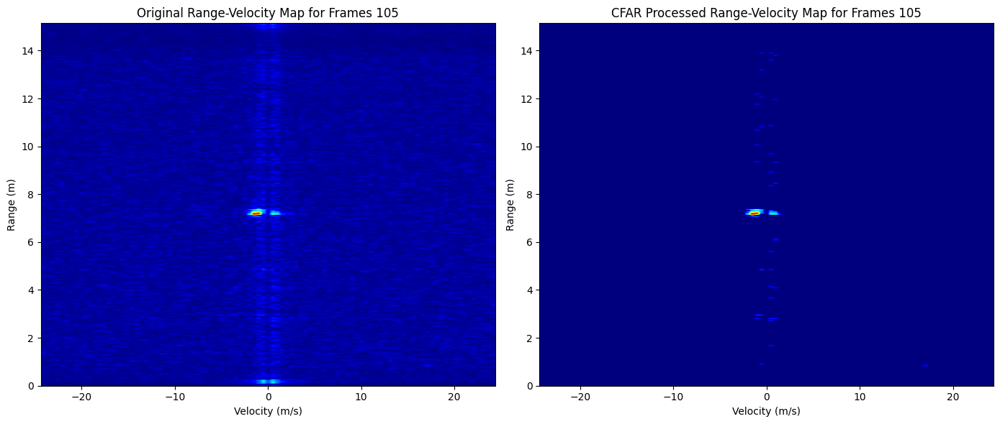

8512.792790794469


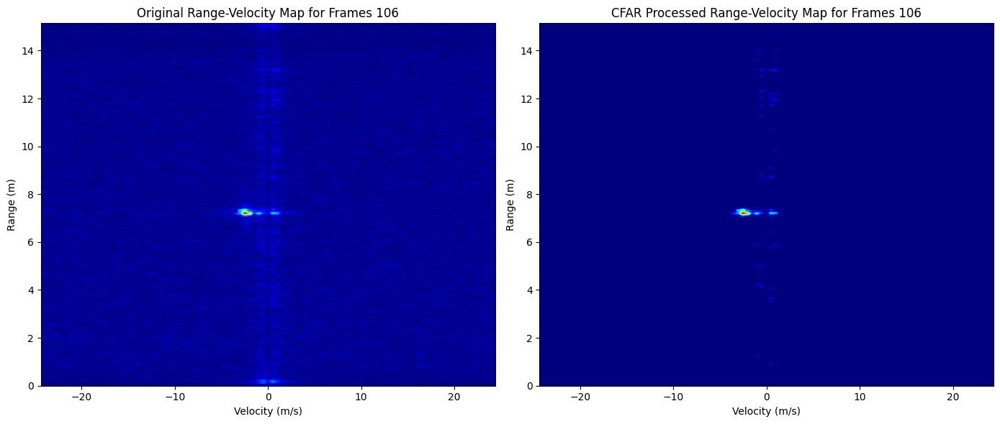

8608.190659938899


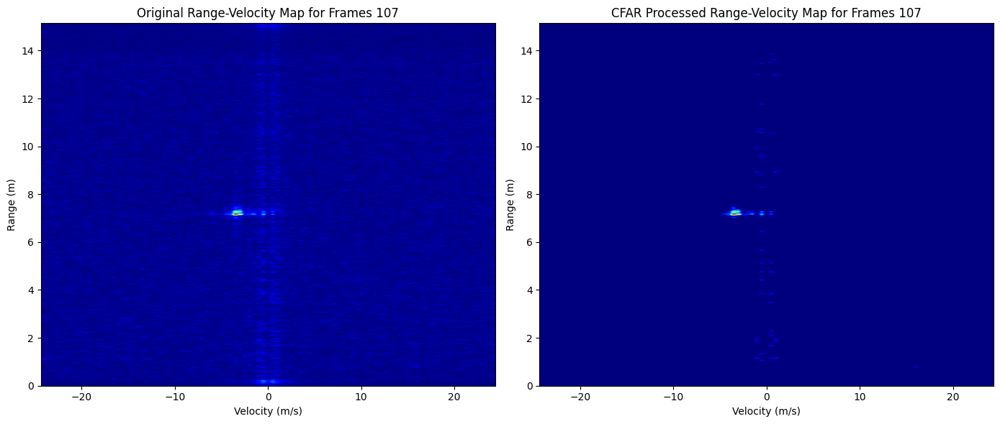

8460.588949253044


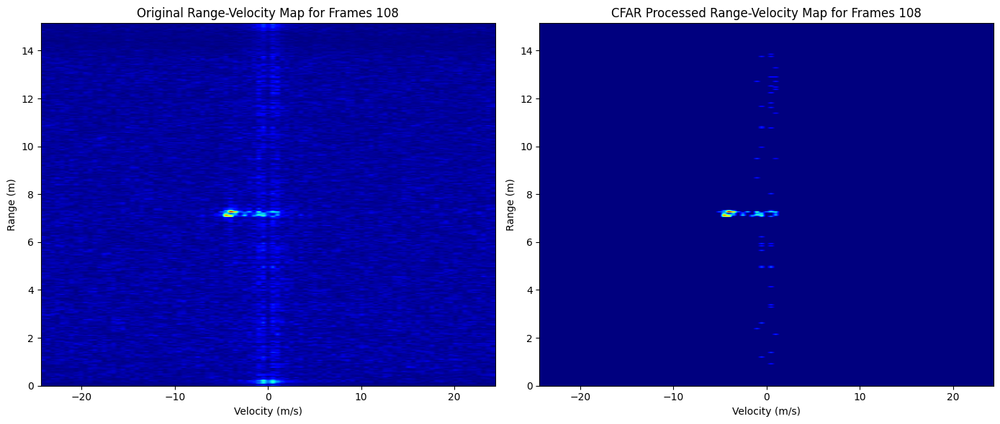

8658.036992228192


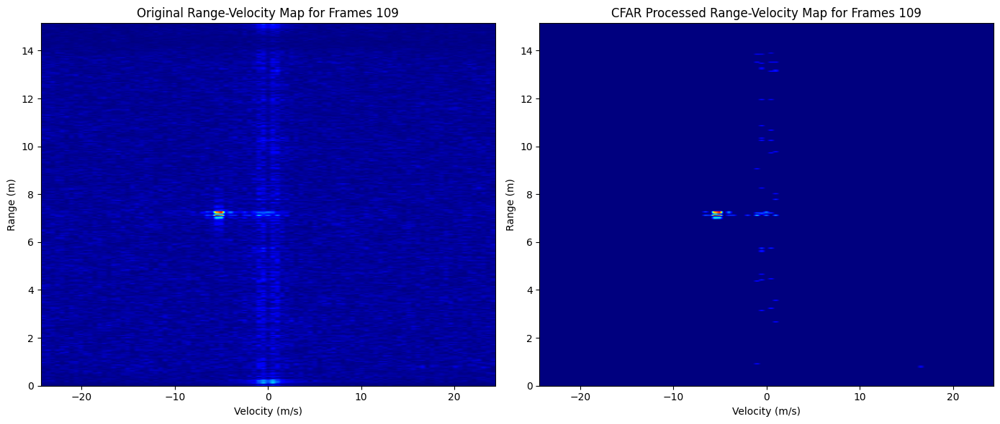

8553.993177348077


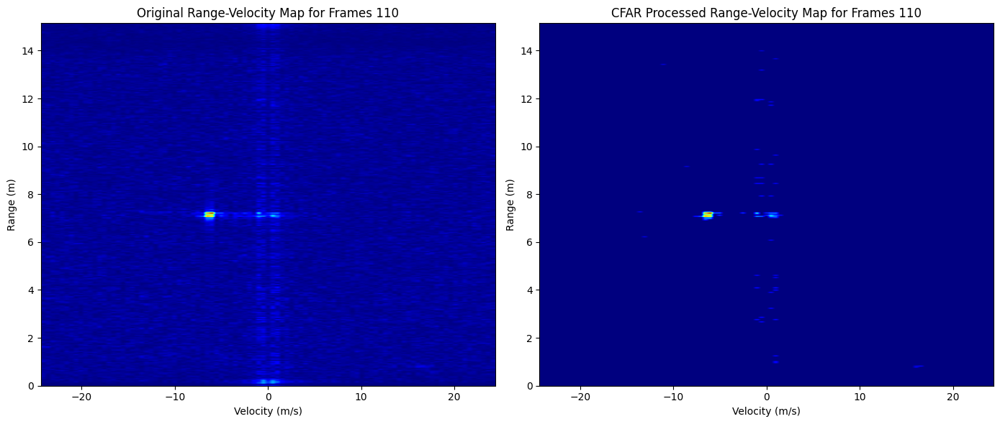

8627.901020207386


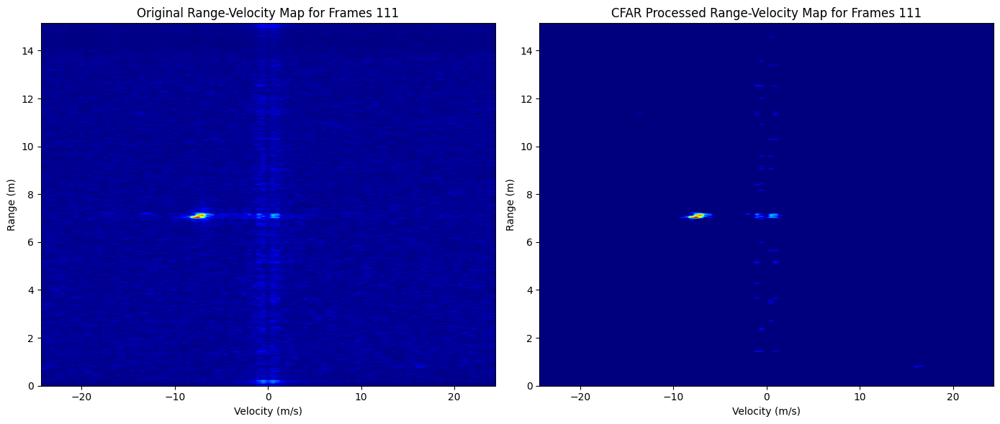

8693.503771532614


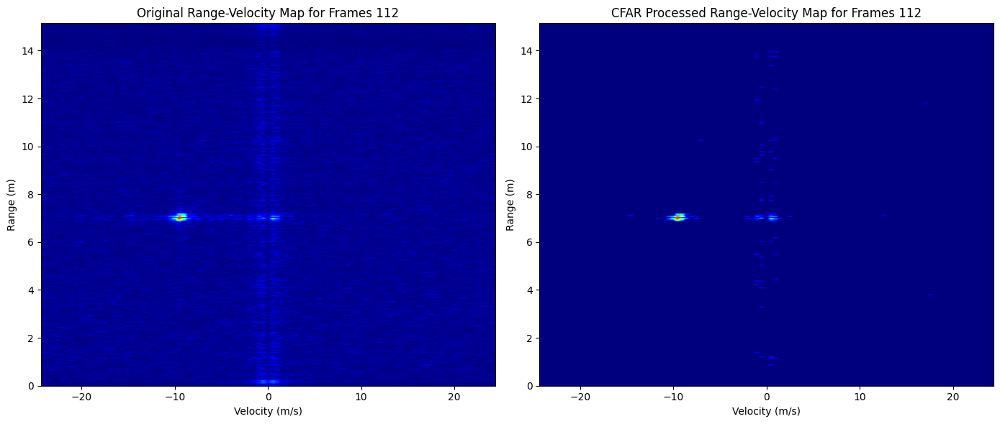

8721.709877312906


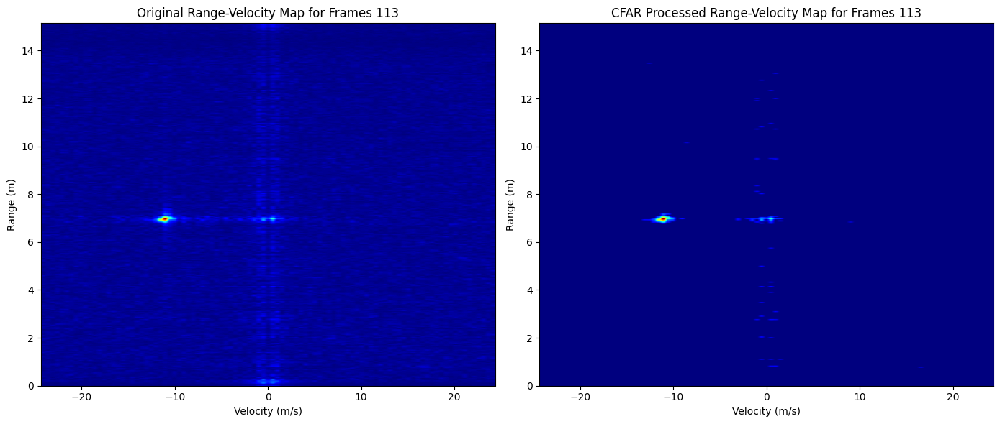

8670.827811123481


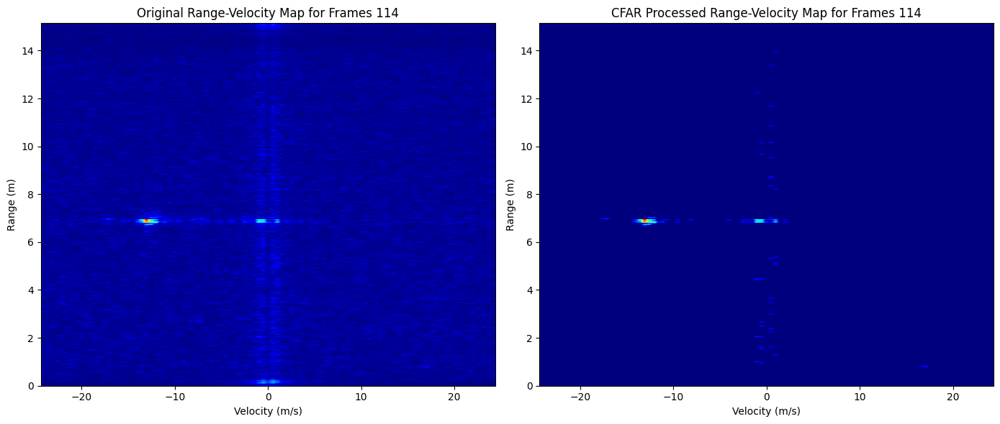

8689.604778732551


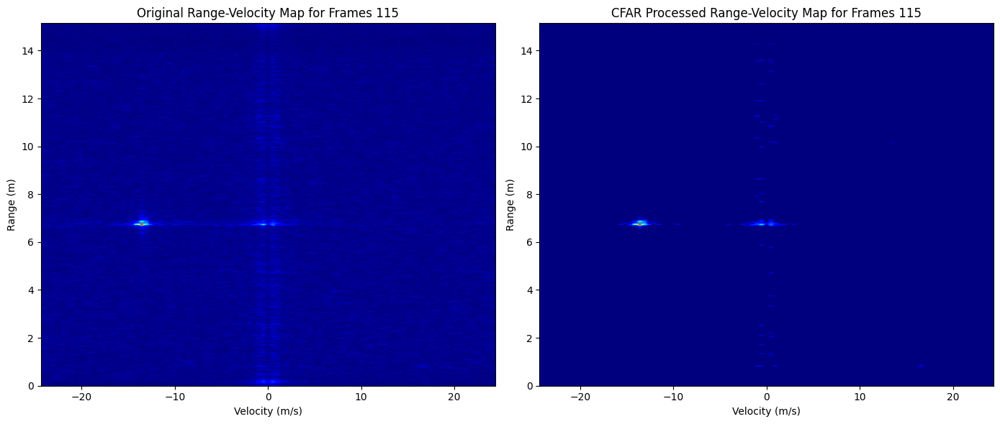

8618.452872748938


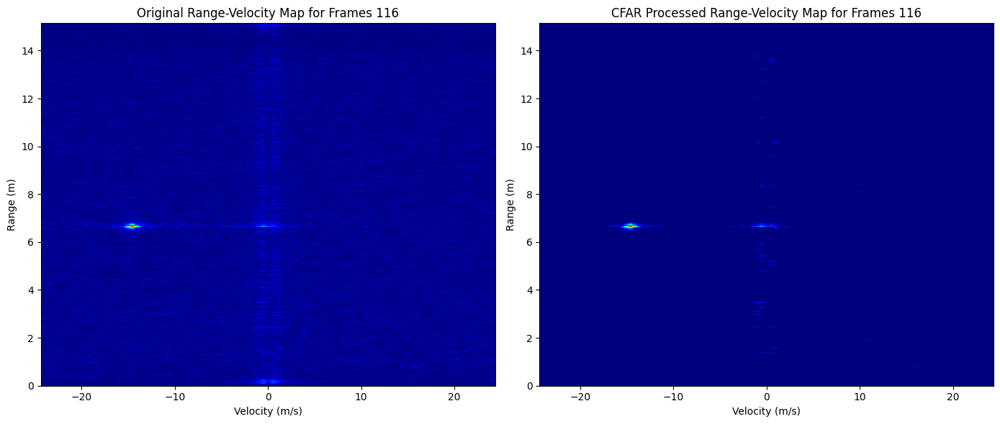

8574.738317722677


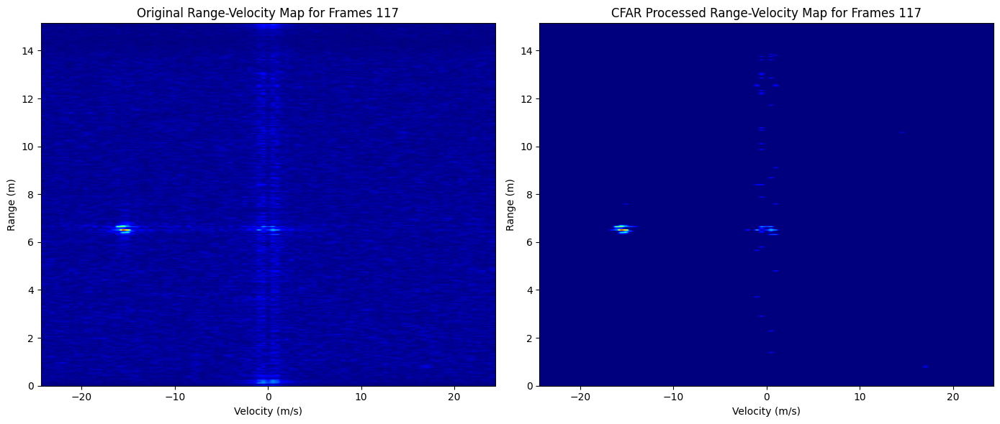

8681.028331343316


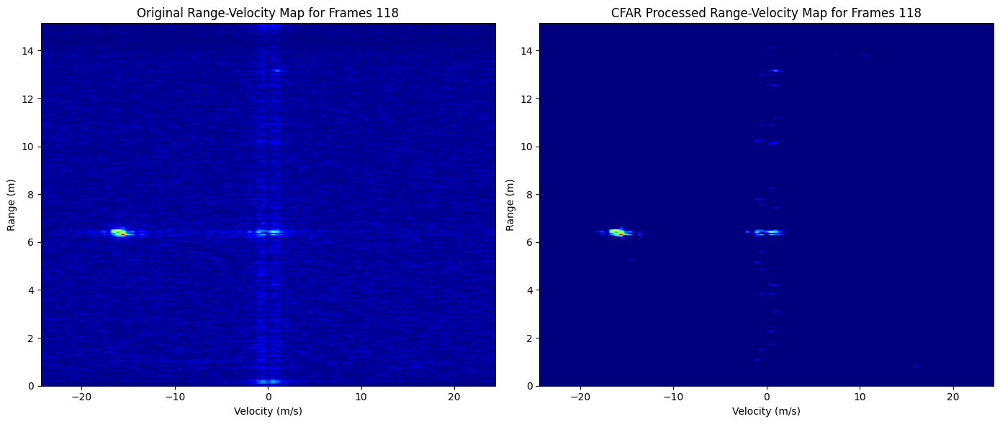

8992.841105888203


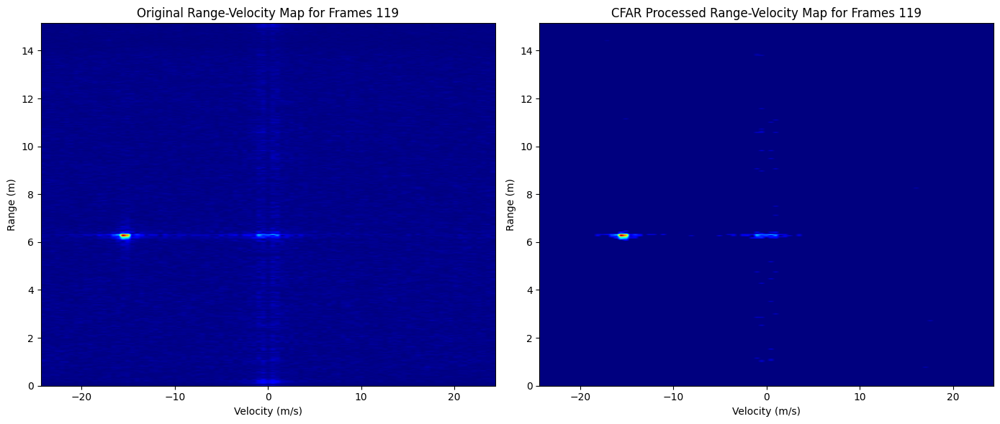

8796.091982788459


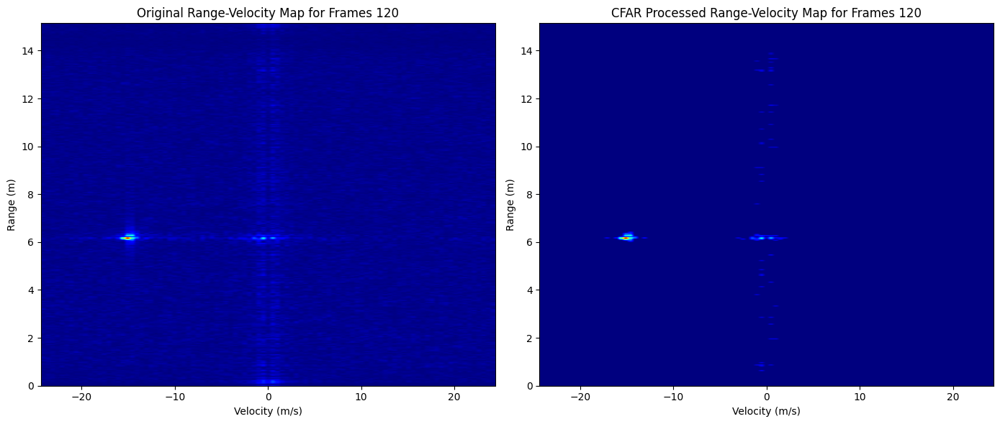

8899.02055907984


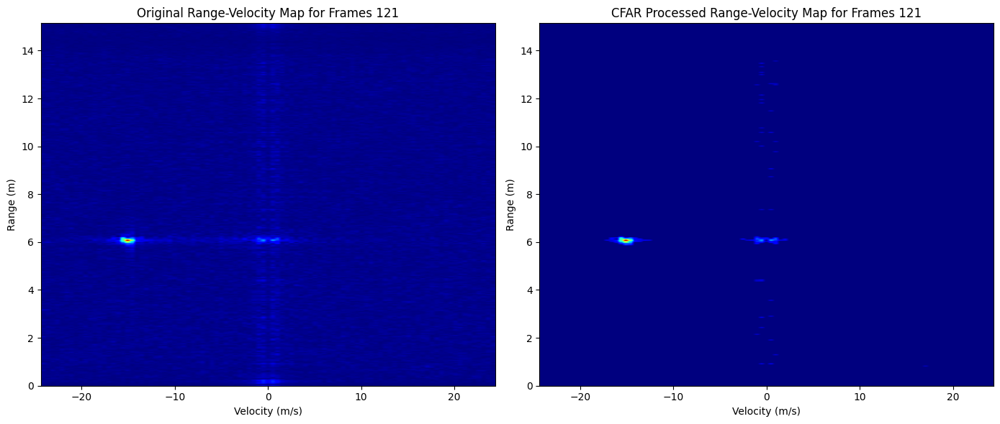

8774.79016821961


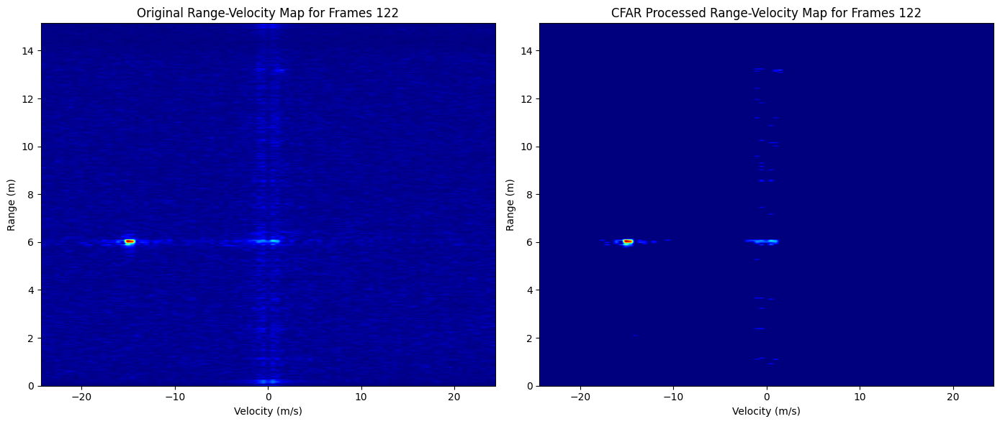

9423.213645426731


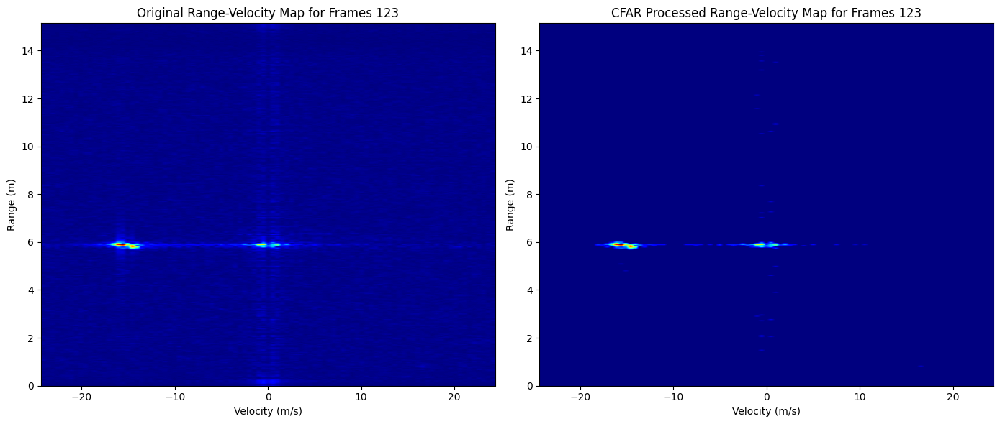

9451.992741474272


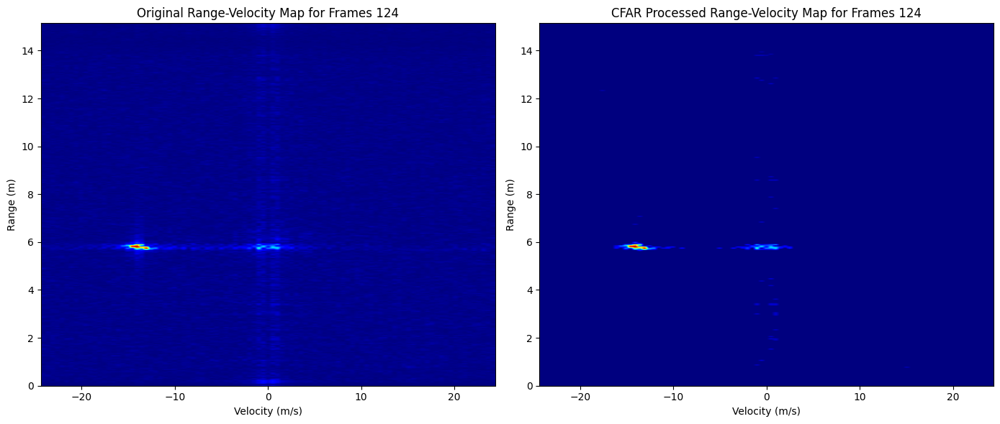

9284.170458684714


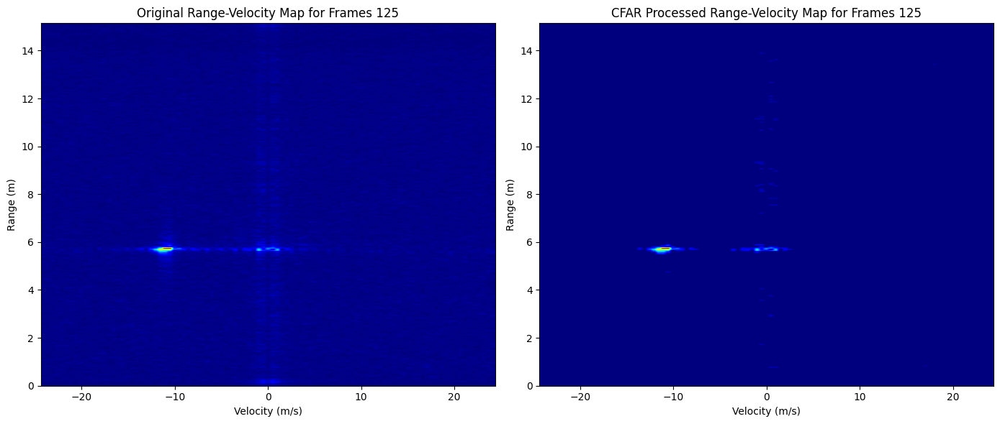

10512.709475736654


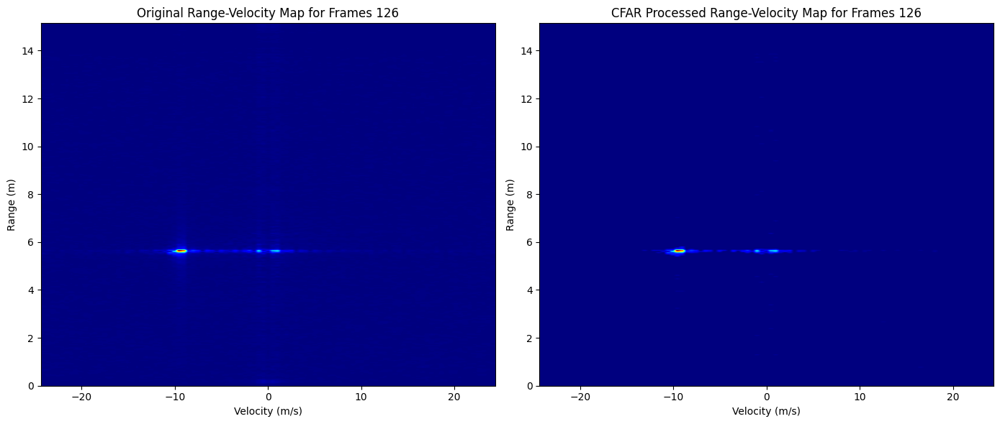

In [15]:
import numpy as np
from scipy import signal
import matplotlib.pyplot as plt
from scipy.signal import butter, filtfilt
import random

# Define file path and parameters
fileFullPath_1 = r'D:\Drone-Swarm-Detection-with-AWR2243\Our data\Radar_Data\Phantom4_3GHz\master_0000_data.bin';
fileFullPath_2 = r'D:\Drone-Swarm-Detection-with-AWR2243\Our data\Radar_Data\Phantom4_3GHz\master_0000_data.bin';
fileFullPath_3 = r'D:\Drone-Swarm-Detection-with-AWR2243\Our data\Radar_Data\Phantom4_3GHz\master_0000_data.bin';
fileFullPath_4 = r'D:\Drone-Swarm-Detection-with-AWR2243\Our data\Radar_Data\Phantom4_3GHz\master_0000_data.bin';
file_paths=[fileFullPath_1]
frameIdx = 50# Index of the frame to read
numSamplePerChirp = 256  # Number of samples per chirp
numChirpPerLoop = 12  # Number of chirps per loop
numLoops = 64 # Number of loops per frame
numRXPerDevice = 4  # Number of receiving channels per device
numDevices = 4  # Number of devices in the cascade (if needed)
# Create the filter for zero Doppler clutter removal
cutoff_freq =10  # Set cutoff frequency for the high-pass filter (Hz)
sampling_freq = 1000  # Sampling frequency (example value, should match your data)
def butter_highpass(cutoff, fs, order=6):
    """Design a Butterworth high-pass filter."""
    nyquist = 0.5 * fs
    normal_cutoff = cutoff / nyquist
    b, a = butter(order, normal_cutoff, btype='high', analog=False)
    return b, a
b, a = butter_highpass(cutoff_freq, sampling_freq)
# Function to read binary radar data
def readBinFile(fileFullPath, frameIdx, numSamplePerChirp, numChirpPerLoop, numLoops, numRXPerDevice):
    Expected_Num_SamplesPerFrame = numSamplePerChirp * numChirpPerLoop * numLoops * numRXPerDevice * 2
    with open(fileFullPath, 'rb') as fp:
        # Move to the desired frame in the file
        fp.seek((frameIdx - 1) * Expected_Num_SamplesPerFrame * 2)
        adcData1 = np.fromfile(fp, dtype=np.uint16, count=Expected_Num_SamplesPerFrame)

    # Convert the 16-bit data to signed integers
    neg = (adcData1 >> 15) == 1  # Check the sign bit
    adcData1 = adcData1.astype(np.int32)
    adcData1[neg] -= 2**16

    # Combine the I and Q channels into complex values
    adcData1 = adcData1[0::2] + 1j * adcData1[1::2]

    # Reshape and permute the data
    adcData1Complex = np.reshape(adcData1, (numRXPerDevice, numSamplePerChirp, numChirpPerLoop, numLoops), order='F')
    adcData1Complex = np.transpose(adcData1Complex, (1, 3, 0, 2))  # Permute dimensions
    return adcData1Complex

# Define CFAR parameters
numTrainingCells = 10
numGuardCells = 2
P_fa = 1e-22  # Desired probability of false alarm
def cfar_2d(magnitude_array, numTrainingCells, numGuardCells, P_fa):
    # Get the dimensions of the range-Doppler map
    magnitude_rows, magnitude_cols = magnitude_array.shape
    cfar_output = np.zeros_like(magnitude_array)

    # Loop through the Range-Doppler Map to apply CFAR
    for rangeIdx in range(numTrainingCells + numGuardCells, magnitude_rows - numTrainingCells - numGuardCells):
        for dopplerIdx in range(numTrainingCells + numGuardCells, magnitude_cols - numTrainingCells - numGuardCells):
            # Define the training region (excluding the guard cells)
            training_region = magnitude_array[
                rangeIdx - numTrainingCells - numGuardCells : rangeIdx + numTrainingCells + numGuardCells + 1,
                dopplerIdx - numTrainingCells - numGuardCells : dopplerIdx + numTrainingCells + numGuardCells + 1
            ].copy()

            # Exclude the guard cells by setting them to zero
            training_region[
                numTrainingCells : -numTrainingCells,
                numGuardCells : -numGuardCells
            ] = 0

            # Estimate the noise level from the training region (non-zero values only)
            noise_level = np.mean(training_region[training_region != 0])

            # Calculate the CFAR threshold
            threshold = noise_level * (P_fa ** (-1 / (2 * numTrainingCells * numGuardCells)))
            
            # Compare the cell's value to the threshold
            if magnitude_array[rangeIdx, dopplerIdx] > threshold:
                cfar_output[rangeIdx, dopplerIdx] = magnitude_array[rangeIdx, dopplerIdx]

    return cfar_output


# Define the range of possible values
min_value = 4
max_value = 20

# Number of values in the list
num_values = 4

# Function to check if all values in the list have a minimum distance of 3
def has_minimum_distance(values, min_distance=3):
    # Check the distance between each pair of values
    return all(abs(values[i] - values[j]) >= min_distance for i in range(len(values)) for j in range(i + 1, len(values)))

# Generate up to 30 unique valid combinations
valid_combinations = set()

while len(valid_combinations) < 1:
    # Randomly select 4 values within the range
    candidate = random.sample(range(min_value, max_value + 1), num_values)
    
    # Check if the candidate list meets the minimum distance requirement
    if has_minimum_distance(candidate):
        # Convert the list to a tuple to ensure uniqueness in the set
        valid_combinations.add(tuple(candidate))

# Convert each tuple back to a list and print the results
for comb in valid_combinations:
    print(list(comb))
    #frame_num_list=list(comb)
    frame_num_list=[i for i in range(1,128)]
    add_both_chirps_matrix = np.zeros((256, 64))

    for i in range(len(frame_num_list)):

        adcDataComplex= readBinFile(file_paths[0], frame_num_list[i], numSamplePerChirp, numChirpPerLoop, numLoops, numRXPerDevice)

        # Select antenna index and extract chirp ADC matrix
        # chirp_ADC_matrix = adcDataComplex[:, :, 3, :]
        # specific_transmitter_data = chirp_ADC_matrix[:, :, 0].T
        # if filter and b is not None and a is not None:
        #     specific_transmitter_data = filtfilt(b,a,specific_transmitter_data , axis=0)
        # chirps_matrix = specific_transmitter_data.T
        # specific_transmitter_data=np.transpose(specific_transmitter_data)
        # add_both_chirps_matrix=add_both_chirps_matrix+specific_transmitter_data
        chirp_ADC_matrix = adcDataComplex[:, :, 3, :]
        specific_transmitter_data = chirp_ADC_matrix[:, :, 0]
      
       
        add_both_chirps_matrix=specific_transmitter_data
        
        fc = 77e9
        c = 3e8
        sweepBandwidth =3.16e9
        chirpDuration = 40e-6

        
        if filter and b is not None and a is not None:
                add_both_chirps_matrix=np.transpose(add_both_chirps_matrix)
                add_both_chirps_matrix = filtfilt(b,a,add_both_chirps_matrix , axis=0)
                add_both_chirps_matrix=np.transpose(add_both_chirps_matrix)
                chirps_matrix = add_both_chirps_matrix

        # Define parameters
        slope = 78.9857e12
        chirp_duration = 40e-6
        c = 3e8  # Speed of light in m/s
        radar_data= chirps_matrix 
        # Assuming radar_data is already defined as a numpy array
        n_samples = radar_data.shape[1]  # Get number of samples per chirp
        n_chirps = radar_data.shape[0]  # Get number of chirps

        # Calculate the sample rate
        sample_rate = n_samples / chirp_duration

        # Create the time vector for range shift
        time = np.arange(n_samples) / sample_rate
        range_shift = 0

        # Calculate the frequency shift due to range shift
        frequency_shift_range = 2 * slope * range_shift / c

        # Calculate the phase shift for range shift
        phase_shift_range = 2 * np.pi * frequency_shift_range * time

        # Apply the range phase shift to radar data
        shifted_data_array = radar_data * np.exp(-1j * phase_shift_range)

        # Define velocity shift
        velocity_shift = 0

        # Create the time vector for velocity shift (column vector)
        time_velocity = np.arange(n_chirps) * chirp_duration

        # Calculate the frequency shift due to velocity shift
        frequency_shift_velocity = 2 * slope * velocity_shift / c

        # Calculate the phase shift for velocity shift
        phase_shift_velocity = 2 * np.pi * frequency_shift_velocity * time_velocity

        # Apply the velocity phase shift to the radar data
        shifted_data_array = shifted_data_array * np.exp(1j * phase_shift_velocity[:, np.newaxis])  # Broadcasting phase shift across samples


        Nfft_range = 320
        Nfft_doppler = 97

        range_fft = np.fft.fft(shifted_data_array, Nfft_range, axis=0)
        doppler_fft = np.fft.fftshift(np.fft.fft(range_fft, Nfft_doppler, axis=1), axes=1)
        


        range_res = c / (2 * sweepBandwidth)
        max_range = range_res * (Nfft_range - 1)
        range_axis = np.linspace(0, max_range, Nfft_range)

        velocity_res = (c / fc) / (2 * numLoops * chirpDuration * 12)
        max_velocity = (c / fc) / (chirpDuration * 4)
        velocity_axis = np.linspace(-max_velocity, max_velocity, Nfft_doppler)
        mean_value=np.mean(np.abs(doppler_fft))
        print( mean_value)
        final_matrix=np.abs(doppler_fft)
    
        cfar_result = cfar_2d(final_matrix, numTrainingCells, numGuardCells, P_fa)
   
        # Create a figure with two subplots (1 row, 2 columns)
        fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 6))

        # Plot the original Range-Velocity Map
        im1 = ax1.imshow( final_matrix, aspect='auto', extent=[velocity_axis[0], velocity_axis[-1], range_axis[0], range_axis[-1]], 
                        origin='lower', cmap='jet')
        ax1.set_title(f'Original Range-Velocity Map for Frames {i}')
        ax1.set_xlabel('Velocity (m/s)')
        ax1.set_ylabel('Range (m)')


        # Plot the CFAR Processed Range-Velocity Map
        im2 = ax2.imshow(cfar_result, aspect='auto', extent=[velocity_axis[0], velocity_axis[-1], range_axis[0], range_axis[-1]], 
                        origin='lower', cmap='jet')
        ax2.set_title(f'CFAR Processed Range-Velocity Map for Frames {i}')
        ax2.set_xlabel('Velocity (m/s)')
        ax2.set_ylabel('Range (m)')
    

        # Display the plots
        plt.tight_layout()
        plt.show()
            

